# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [398]:
data_dir = './data'
# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline

import helper
import pickle as pkl


helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

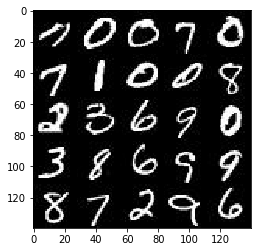

In [399]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
#calling it a second time may prevent some graphics errors
import os
from glob import glob

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
plt.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

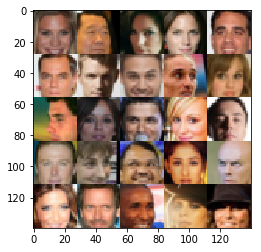

In [400]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
plt.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [401]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import tensorflow as tf

from distutils.version import LooseVersion
import warnings

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

TensorFlow Version: 1.12.0


In [402]:

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

Default GPU Device: /device:GPU:0


In [403]:
from tensorflow.python.client import device_lib

print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 5992464436237656680
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 1829406169414778256
physical_device_desc: "device: XLA_GPU device"
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 13976883621990353471
physical_device_desc: "device: XLA_CPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 3368222720
locality {
  bus_id: 1
  links {
  }
}
incarnation: 16243217540311112941
physical_device_desc: "device: 0, name: GeForce 940MX, pci bus id: 0000:01:00.0, compute capability: 5.0"
]


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [404]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_inputs = tf.placeholder(tf.float32, shape=(None, image_width, image_height, image_channels), 
                                 name='input_real')

    z_data = tf.placeholder(tf.float32, shape=(None, z_dim), name='input_z')
    
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')
    
    return (real_inputs, z_data, learning_rate)


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [406]:
def discriminator(images, reuse=False, alpha = 0.4):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse=reuse):
           
        x = tf.layers.conv2d(images,64,5,strides=2, padding='same')
        x = tf.maximum(alpha * x, x)
        
        x = tf.layers.conv2d(x,128,5,strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        
        x = tf.layers.conv2d(x,256,5,strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)

        flat = tf.reshape(x, (-1, 4 * 4 * 256))
        
        #logits = tf.layers.dropout(logits, rate=0.6)
        logits = tf.layers.dense(flat, 1, activation= None)
        
        out = tf.sigmoid(logits)
    return (out, logits)
    

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [407]:
def generator(z, out_channel_dim, is_train=True,  alpha = 0.1 ):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    
     # TODO: Implement Function
    with tf.variable_scope('generator', reuse=not(is_train)):
        
        # First fully connected layer
        x = tf.layers.dense(z, 7*7*256, activation=None)       
        x = tf.reshape(x, (-1, 7 ,7 , 256))

        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        # 7x7x64
        
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        # 14x14x32 
        
        x = tf.layers.conv2d_transpose(x, 64, 5, strides=1, padding='same')
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        # 14x14x16
        
        x = tf.layers.conv2d_transpose(x, 32, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=is_train)
        x = tf.maximum(alpha * x, x)
        # 28x28x8

        
        logits = tf.layers.conv2d_transpose(x , out_channel_dim, 5, strides=1, padding='same')
        
        out = tf.tanh(logits)
    
    return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [408]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    
    smooth = 0.1 
    
    g_fake_model = generator(input_z, out_channel_dim)
    
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_fake_model, True)
    
    #Discriminator loss
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, 
                                                labels=tf.ones_like(d_logits_real)))
    
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, 
                                                labels=tf.zeros_like(d_logits_fake)))
    
    
    d_loss = d_loss_real + d_loss_fake
    
    #Generator Loss
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_logits_fake)))

    return (d_loss, g_loss)



"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [409]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Run optimizer
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [410]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    plt.imshow(images_grid, cmap=cmap)
    plt.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [411]:
def train(epochs, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    
    steps = 0

    input_real, input_z, lr  = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    
    d_train_optimizer, g_train_optimizer = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    with tf.Session() as sess:
        
        sess.run(tf.global_variables_initializer())
        
        for epoch_i in range(epochs):
            
            for batch_images in get_batches(batch_size):
                
                steps += 1
                batch_images *= 2
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                 # Run optimizers
                _ = sess.run(d_train_optimizer, feed_dict={input_z: batch_z, input_real : batch_images, lr: learning_rate})
                _ = sess.run(g_train_optimizer, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                
                if steps % 10 == 0:
                    
                    show_generator_output(sess, 25, input_z, data_shape[3], data_image_mode)
                    
                    train_loss_d = d_loss.eval(feed_dict= {input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval(feed_dict = {input_z: batch_z})
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

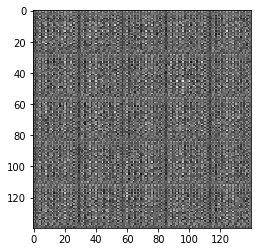

Epoch 1/2... Discriminator Loss: 0.7130... Generator Loss: 0.9614


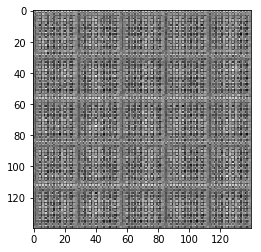

Epoch 1/2... Discriminator Loss: 0.5277... Generator Loss: 1.3646


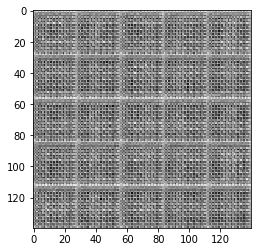

Epoch 1/2... Discriminator Loss: 0.6627... Generator Loss: 1.3968


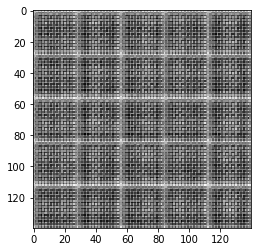

Epoch 1/2... Discriminator Loss: 1.3976... Generator Loss: 0.5463


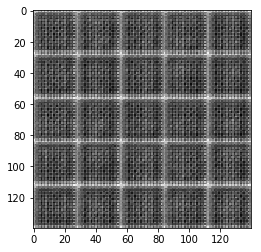

Epoch 1/2... Discriminator Loss: 1.6329... Generator Loss: 2.4893


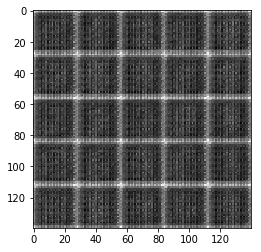

Epoch 1/2... Discriminator Loss: 0.8853... Generator Loss: 1.7517


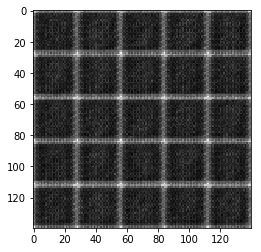

Epoch 1/2... Discriminator Loss: 0.7037... Generator Loss: 3.3473


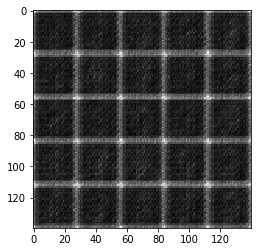

Epoch 1/2... Discriminator Loss: 0.4758... Generator Loss: 1.5873


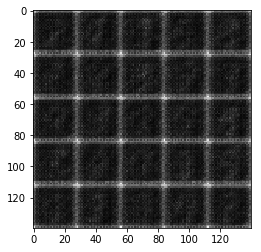

Epoch 1/2... Discriminator Loss: 0.6003... Generator Loss: 1.4001


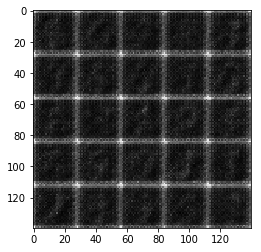

Epoch 1/2... Discriminator Loss: 0.9194... Generator Loss: 2.1773


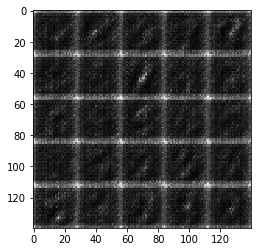

Epoch 1/2... Discriminator Loss: 0.8640... Generator Loss: 0.9355


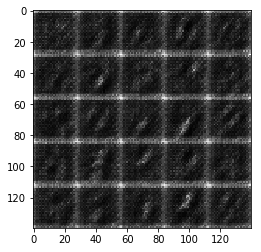

Epoch 1/2... Discriminator Loss: 0.6527... Generator Loss: 1.7085


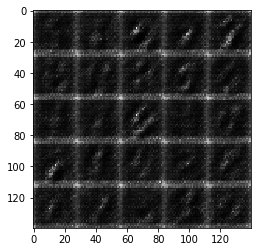

Epoch 1/2... Discriminator Loss: 0.7665... Generator Loss: 2.2668


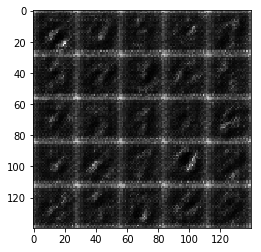

Epoch 1/2... Discriminator Loss: 0.9552... Generator Loss: 3.0566


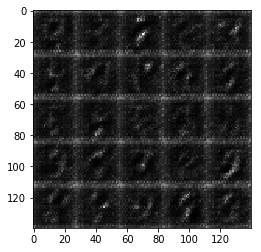

Epoch 1/2... Discriminator Loss: 0.8682... Generator Loss: 0.8772


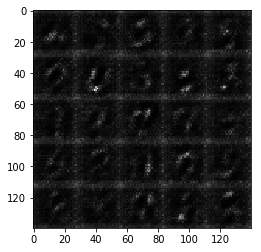

Epoch 1/2... Discriminator Loss: 0.9177... Generator Loss: 1.2197


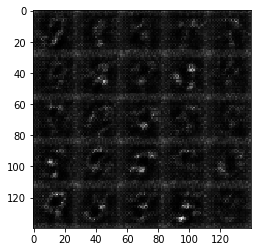

Epoch 1/2... Discriminator Loss: 0.9265... Generator Loss: 1.0867


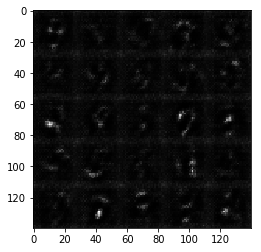

Epoch 1/2... Discriminator Loss: 0.9233... Generator Loss: 0.8522


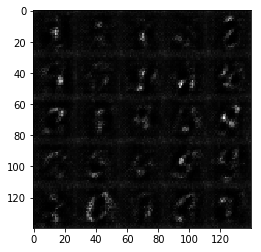

Epoch 1/2... Discriminator Loss: 0.9574... Generator Loss: 1.5793


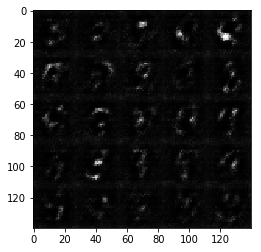

Epoch 1/2... Discriminator Loss: 1.0738... Generator Loss: 0.5838


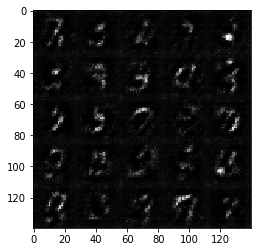

Epoch 1/2... Discriminator Loss: 0.8552... Generator Loss: 1.0270


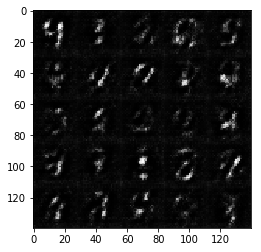

Epoch 1/2... Discriminator Loss: 1.2304... Generator Loss: 2.1451


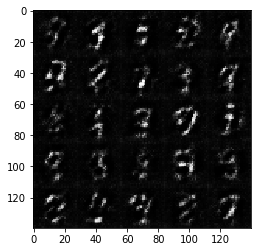

Epoch 1/2... Discriminator Loss: 0.8389... Generator Loss: 1.3309


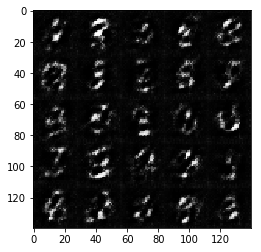

Epoch 1/2... Discriminator Loss: 1.2477... Generator Loss: 2.1402


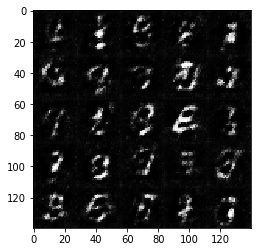

Epoch 1/2... Discriminator Loss: 0.8454... Generator Loss: 1.1494


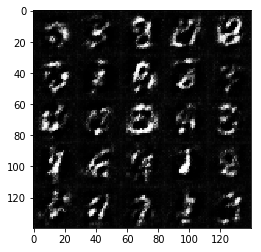

Epoch 1/2... Discriminator Loss: 0.9598... Generator Loss: 1.5348


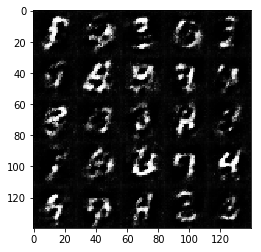

Epoch 1/2... Discriminator Loss: 1.1460... Generator Loss: 1.9273


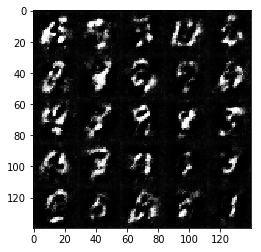

Epoch 1/2... Discriminator Loss: 1.1321... Generator Loss: 0.5718


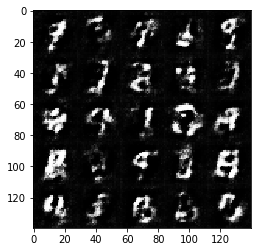

Epoch 1/2... Discriminator Loss: 0.9228... Generator Loss: 1.2874


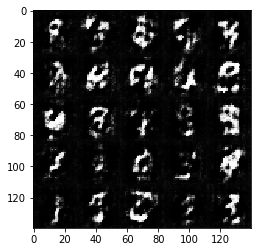

Epoch 1/2... Discriminator Loss: 1.4821... Generator Loss: 2.2083


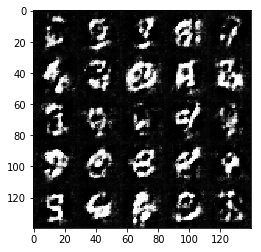

Epoch 1/2... Discriminator Loss: 0.8470... Generator Loss: 0.8025


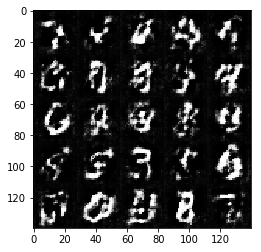

Epoch 1/2... Discriminator Loss: 0.9834... Generator Loss: 1.0286


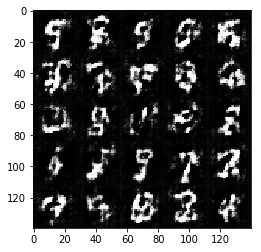

Epoch 1/2... Discriminator Loss: 1.3669... Generator Loss: 2.3754


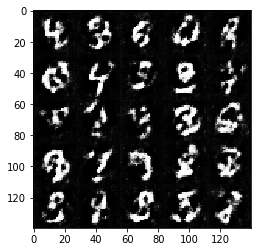

Epoch 1/2... Discriminator Loss: 0.9371... Generator Loss: 0.7665


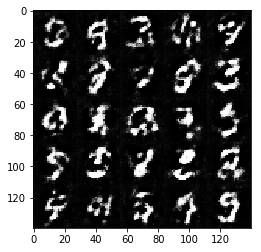

Epoch 1/2... Discriminator Loss: 0.8973... Generator Loss: 1.2275


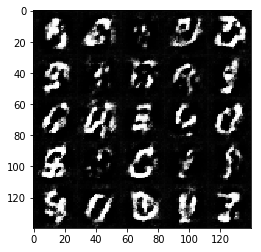

Epoch 1/2... Discriminator Loss: 1.0245... Generator Loss: 1.6810


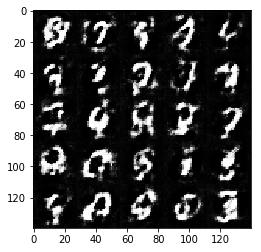

Epoch 1/2... Discriminator Loss: 0.8849... Generator Loss: 0.8348


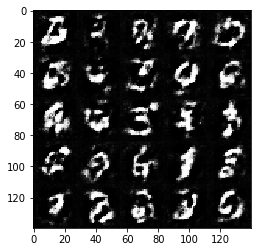

Epoch 1/2... Discriminator Loss: 0.9002... Generator Loss: 0.7681


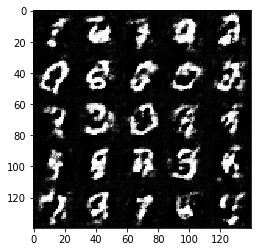

Epoch 1/2... Discriminator Loss: 0.7971... Generator Loss: 1.4748


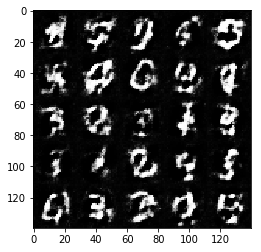

Epoch 1/2... Discriminator Loss: 1.0080... Generator Loss: 1.9798


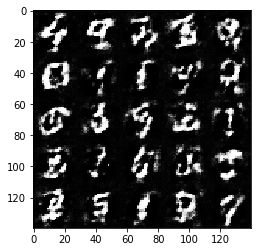

Epoch 1/2... Discriminator Loss: 0.8633... Generator Loss: 1.7116


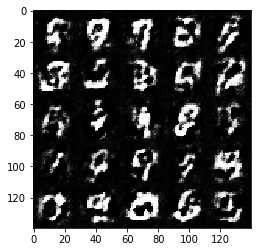

Epoch 1/2... Discriminator Loss: 0.7890... Generator Loss: 0.9708


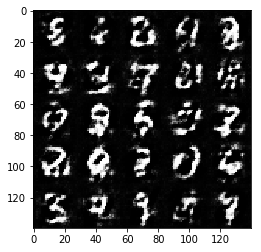

Epoch 1/2... Discriminator Loss: 0.8275... Generator Loss: 1.4067


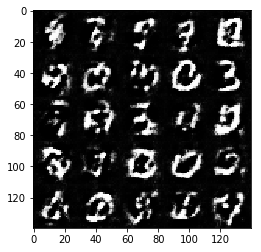

Epoch 1/2... Discriminator Loss: 0.7533... Generator Loss: 1.2733


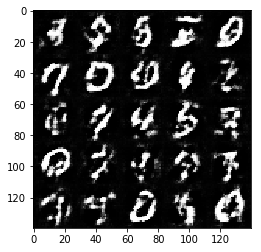

Epoch 1/2... Discriminator Loss: 0.9725... Generator Loss: 1.8086


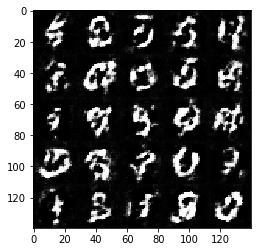

Epoch 1/2... Discriminator Loss: 0.7967... Generator Loss: 1.0241


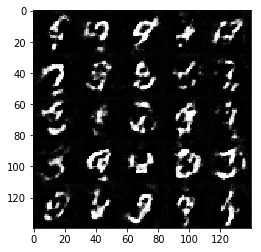

Epoch 2/2... Discriminator Loss: 0.7467... Generator Loss: 1.0541


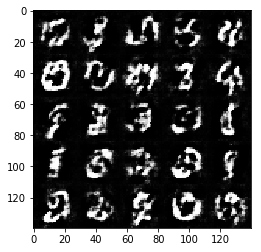

Epoch 2/2... Discriminator Loss: 0.9111... Generator Loss: 0.6664


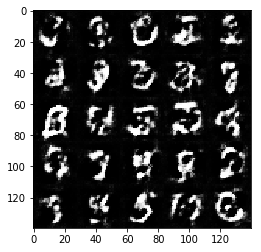

Epoch 2/2... Discriminator Loss: 0.9111... Generator Loss: 0.7034


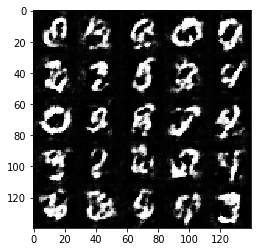

Epoch 2/2... Discriminator Loss: 0.6778... Generator Loss: 1.2054


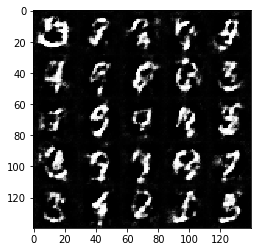

Epoch 2/2... Discriminator Loss: 0.9732... Generator Loss: 2.4512


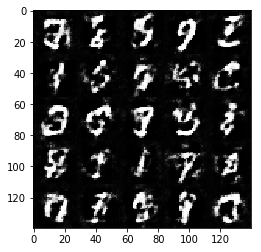

Epoch 2/2... Discriminator Loss: 0.7515... Generator Loss: 1.7675


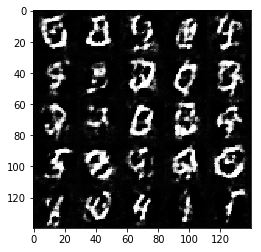

Epoch 2/2... Discriminator Loss: 1.0326... Generator Loss: 0.5831


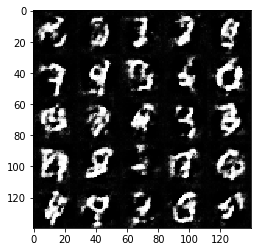

Epoch 2/2... Discriminator Loss: 0.6840... Generator Loss: 1.1686


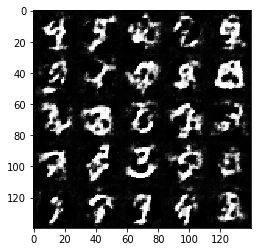

Epoch 2/2... Discriminator Loss: 0.7270... Generator Loss: 1.0865


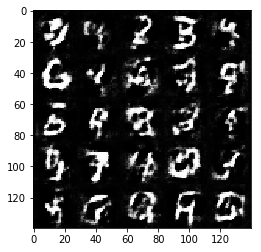

Epoch 2/2... Discriminator Loss: 0.9680... Generator Loss: 0.6070


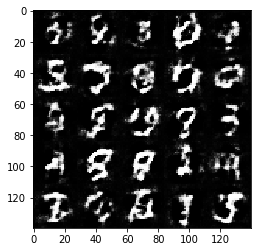

Epoch 2/2... Discriminator Loss: 0.7033... Generator Loss: 1.8151


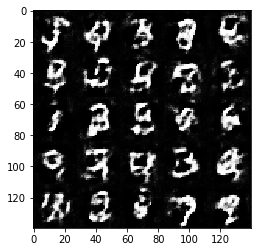

Epoch 2/2... Discriminator Loss: 0.8367... Generator Loss: 1.8383


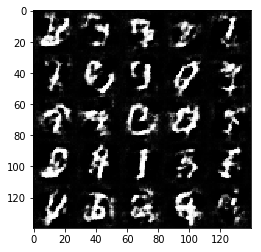

Epoch 2/2... Discriminator Loss: 0.7349... Generator Loss: 1.6312


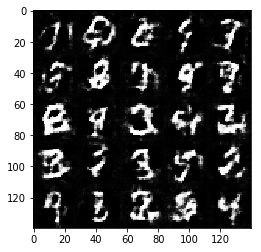

Epoch 2/2... Discriminator Loss: 0.7858... Generator Loss: 0.8665


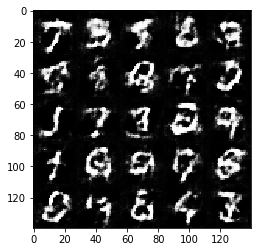

Epoch 2/2... Discriminator Loss: 0.6898... Generator Loss: 1.2532


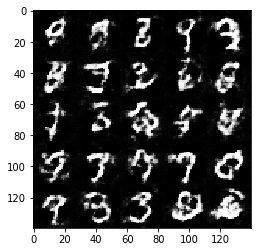

Epoch 2/2... Discriminator Loss: 0.8011... Generator Loss: 1.4083


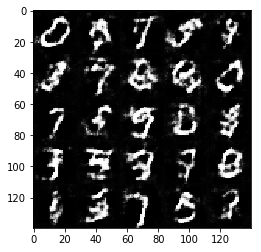

Epoch 2/2... Discriminator Loss: 0.7104... Generator Loss: 1.3110


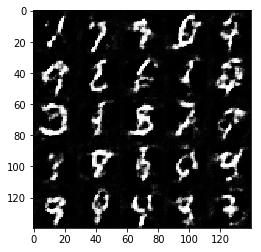

Epoch 2/2... Discriminator Loss: 1.2699... Generator Loss: 2.4330


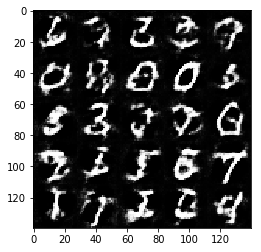

Epoch 2/2... Discriminator Loss: 0.8916... Generator Loss: 0.8401


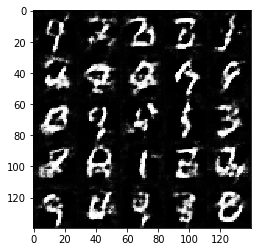

Epoch 2/2... Discriminator Loss: 1.0377... Generator Loss: 2.1858


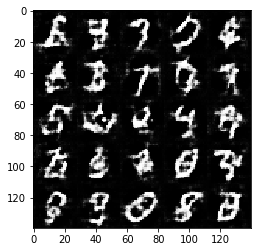

Epoch 2/2... Discriminator Loss: 0.8811... Generator Loss: 0.8571


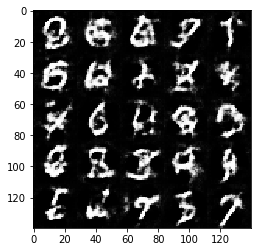

Epoch 2/2... Discriminator Loss: 0.9587... Generator Loss: 0.8845


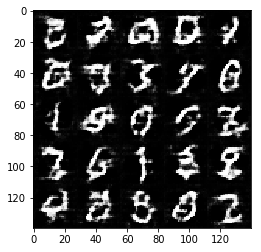

Epoch 2/2... Discriminator Loss: 0.8419... Generator Loss: 1.4415


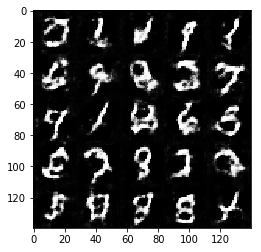

Epoch 2/2... Discriminator Loss: 0.8470... Generator Loss: 0.8152


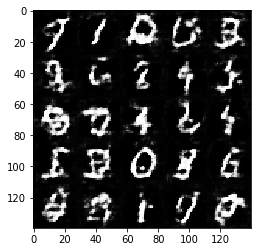

Epoch 2/2... Discriminator Loss: 0.7966... Generator Loss: 0.9984


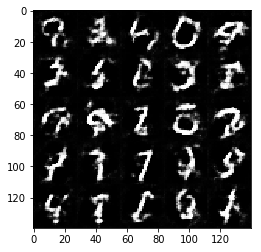

Epoch 2/2... Discriminator Loss: 1.1600... Generator Loss: 0.4886


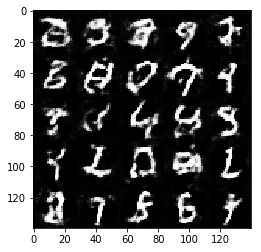

Epoch 2/2... Discriminator Loss: 0.7962... Generator Loss: 1.1629


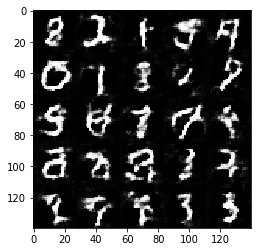

Epoch 2/2... Discriminator Loss: 0.9078... Generator Loss: 0.9727


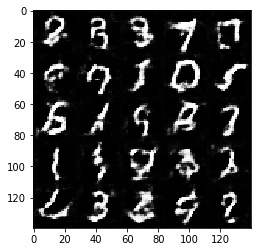

Epoch 2/2... Discriminator Loss: 0.8232... Generator Loss: 1.2225


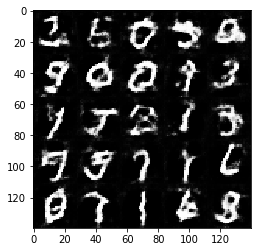

Epoch 2/2... Discriminator Loss: 0.9959... Generator Loss: 1.8375


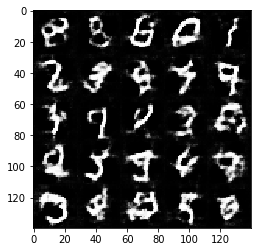

Epoch 2/2... Discriminator Loss: 0.9296... Generator Loss: 0.7952


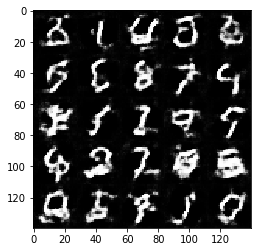

Epoch 2/2... Discriminator Loss: 0.8622... Generator Loss: 1.4091


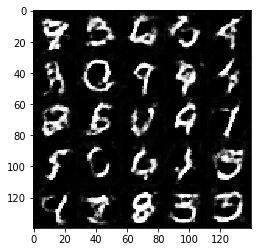

Epoch 2/2... Discriminator Loss: 0.7992... Generator Loss: 1.1086


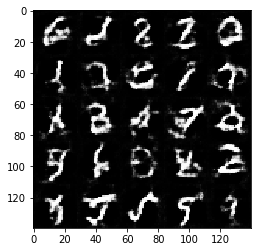

Epoch 2/2... Discriminator Loss: 0.8078... Generator Loss: 1.3708


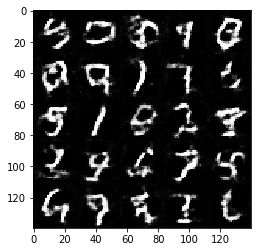

Epoch 2/2... Discriminator Loss: 0.9809... Generator Loss: 2.0052


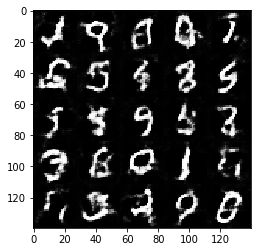

Epoch 2/2... Discriminator Loss: 0.8722... Generator Loss: 1.2171


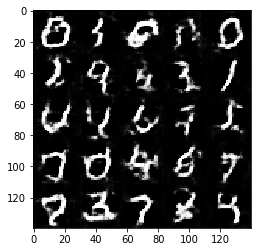

Epoch 2/2... Discriminator Loss: 0.8613... Generator Loss: 1.0484


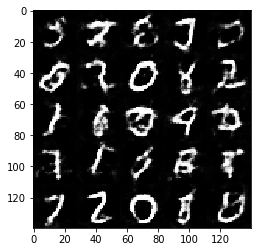

Epoch 2/2... Discriminator Loss: 1.0544... Generator Loss: 1.8928


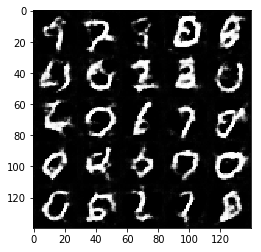

Epoch 2/2... Discriminator Loss: 0.8923... Generator Loss: 1.0472


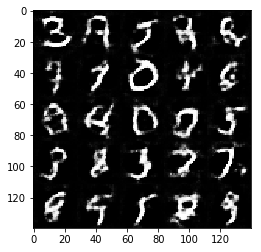

Epoch 2/2... Discriminator Loss: 1.1123... Generator Loss: 0.5548


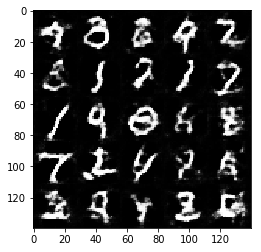

Epoch 2/2... Discriminator Loss: 0.7973... Generator Loss: 1.0227


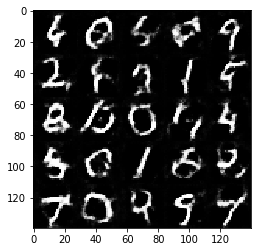

Epoch 2/2... Discriminator Loss: 1.1088... Generator Loss: 2.1975


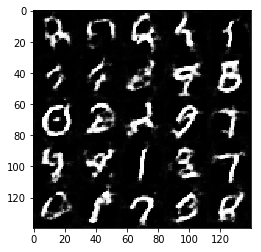

Epoch 2/2... Discriminator Loss: 0.8604... Generator Loss: 1.4119


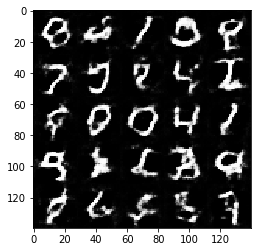

Epoch 2/2... Discriminator Loss: 0.9241... Generator Loss: 1.3836


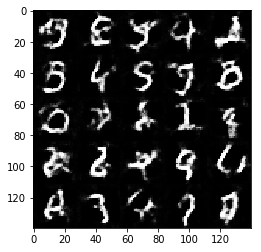

Epoch 2/2... Discriminator Loss: 0.8676... Generator Loss: 1.3511


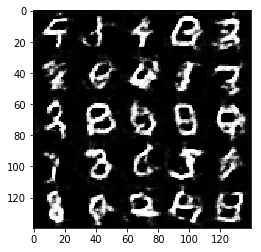

Epoch 2/2... Discriminator Loss: 0.8720... Generator Loss: 1.5634


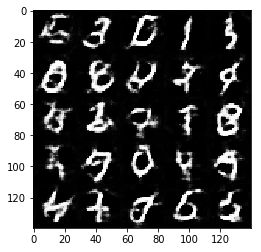

Epoch 2/2... Discriminator Loss: 0.8261... Generator Loss: 0.9966


In [412]:
batch_size = 128
z_dim = 128
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))

with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

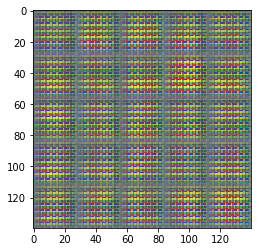

Epoch 1/3... Discriminator Loss: 1.8324... Generator Loss: 15.4550


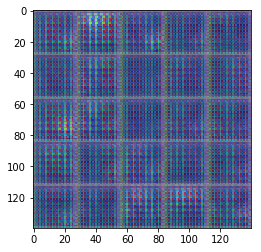

Epoch 1/3... Discriminator Loss: 0.7751... Generator Loss: 3.0194


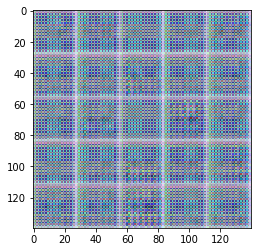

Epoch 1/3... Discriminator Loss: 3.0298... Generator Loss: 0.3107


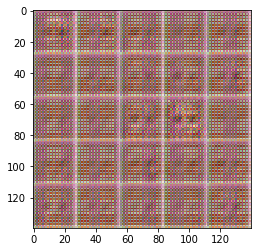

Epoch 1/3... Discriminator Loss: 2.0716... Generator Loss: 0.4926


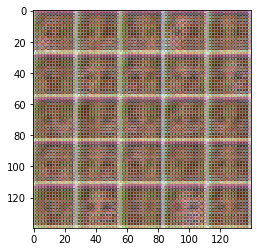

Epoch 1/3... Discriminator Loss: 1.7528... Generator Loss: 1.3001


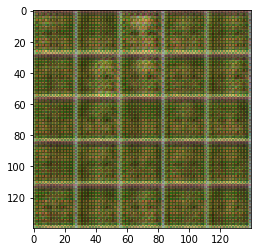

Epoch 1/3... Discriminator Loss: 1.4969... Generator Loss: 0.8541


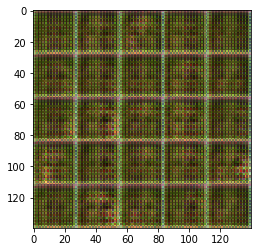

Epoch 1/3... Discriminator Loss: 1.4319... Generator Loss: 1.0106


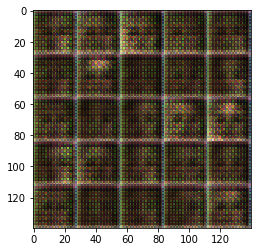

Epoch 1/3... Discriminator Loss: 1.4572... Generator Loss: 0.6385


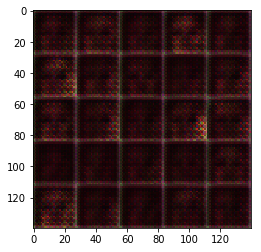

Epoch 1/3... Discriminator Loss: 1.5617... Generator Loss: 0.6562


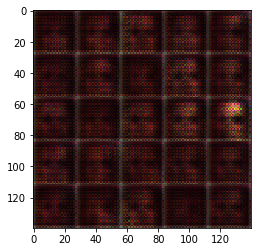

Epoch 1/3... Discriminator Loss: 1.1611... Generator Loss: 0.6626


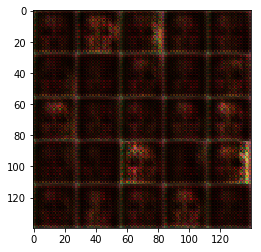

Epoch 1/3... Discriminator Loss: 1.7047... Generator Loss: 0.4702


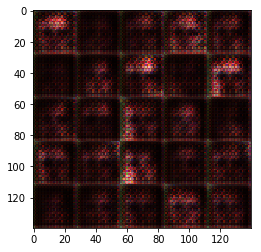

Epoch 1/3... Discriminator Loss: 1.4301... Generator Loss: 0.5202


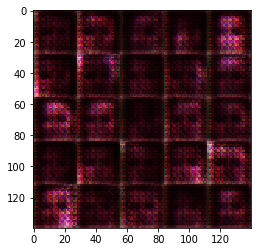

Epoch 1/3... Discriminator Loss: 1.1083... Generator Loss: 1.1489


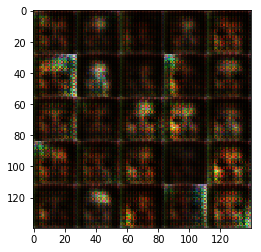

Epoch 1/3... Discriminator Loss: 2.5691... Generator Loss: 0.1476


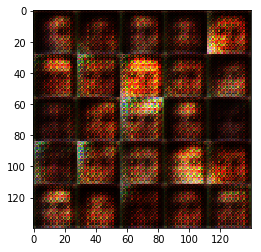

Epoch 1/3... Discriminator Loss: 1.5825... Generator Loss: 0.5558


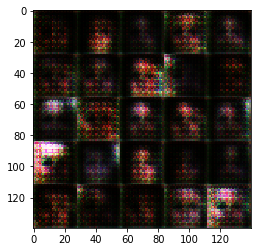

Epoch 1/3... Discriminator Loss: 1.2425... Generator Loss: 0.6599


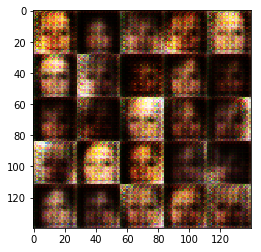

Epoch 1/3... Discriminator Loss: 2.5131... Generator Loss: 0.1055


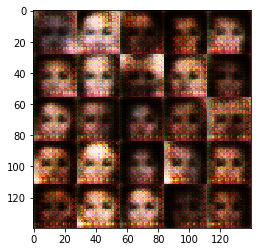

Epoch 1/3... Discriminator Loss: 1.3912... Generator Loss: 0.7722


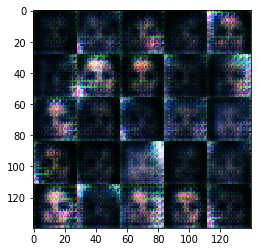

Epoch 1/3... Discriminator Loss: 1.5465... Generator Loss: 0.8910


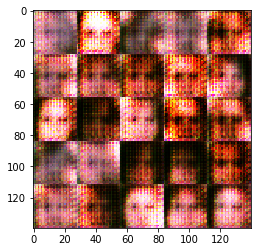

Epoch 1/3... Discriminator Loss: 0.9983... Generator Loss: 0.8660


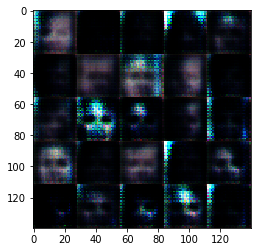

Epoch 1/3... Discriminator Loss: 1.2120... Generator Loss: 0.6645


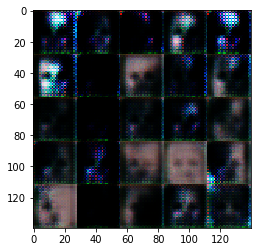

Epoch 1/3... Discriminator Loss: 1.5363... Generator Loss: 0.5024


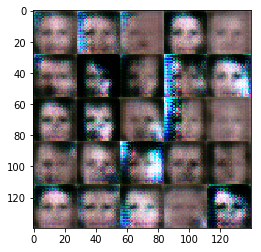

Epoch 1/3... Discriminator Loss: 1.3277... Generator Loss: 0.7982


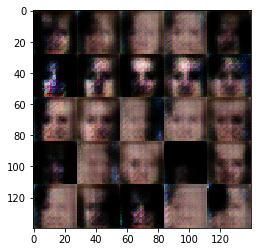

Epoch 1/3... Discriminator Loss: 1.4318... Generator Loss: 0.7976


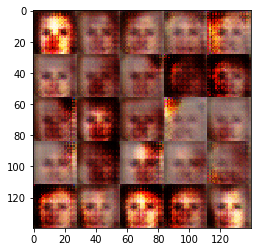

Epoch 1/3... Discriminator Loss: 1.3006... Generator Loss: 0.6487


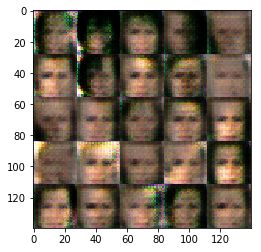

Epoch 1/3... Discriminator Loss: 1.5994... Generator Loss: 0.5526


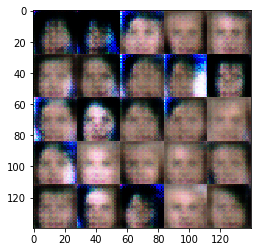

Epoch 1/3... Discriminator Loss: 1.1227... Generator Loss: 0.8964


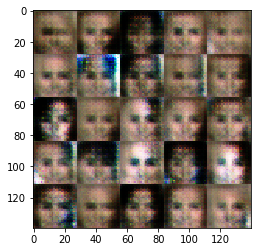

Epoch 1/3... Discriminator Loss: 1.6522... Generator Loss: 0.7140


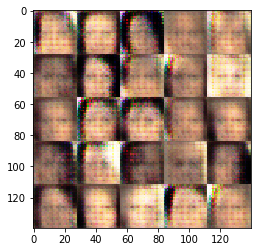

Epoch 1/3... Discriminator Loss: 1.2160... Generator Loss: 1.0394


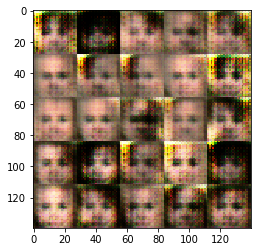

Epoch 1/3... Discriminator Loss: 1.2484... Generator Loss: 1.0569


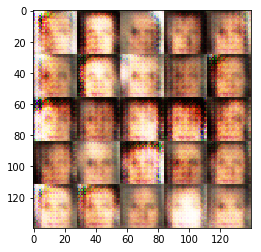

Epoch 1/3... Discriminator Loss: 1.3590... Generator Loss: 1.0777


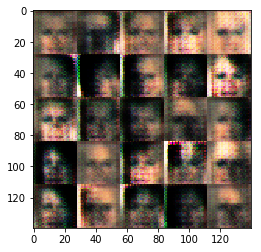

Epoch 1/3... Discriminator Loss: 1.4505... Generator Loss: 0.8266


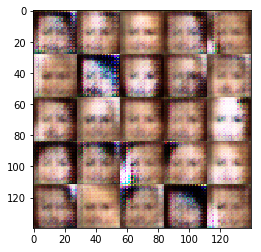

Epoch 1/3... Discriminator Loss: 1.3722... Generator Loss: 0.8438


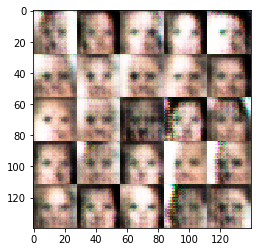

Epoch 1/3... Discriminator Loss: 1.5876... Generator Loss: 1.1690


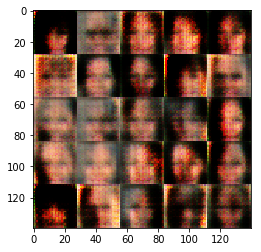

Epoch 1/3... Discriminator Loss: 1.3406... Generator Loss: 0.5654


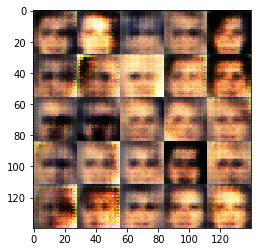

Epoch 1/3... Discriminator Loss: 1.0023... Generator Loss: 0.8838


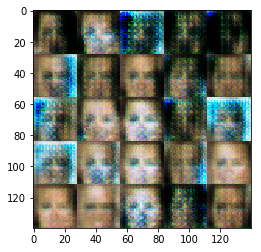

Epoch 1/3... Discriminator Loss: 1.5125... Generator Loss: 0.7107


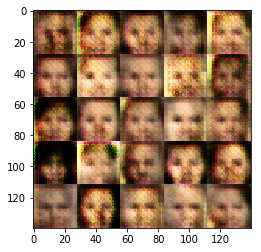

Epoch 1/3... Discriminator Loss: 1.4793... Generator Loss: 0.9142


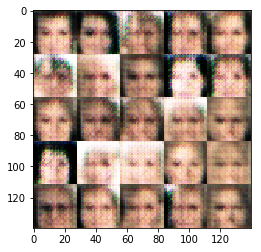

Epoch 1/3... Discriminator Loss: 1.3516... Generator Loss: 0.8020


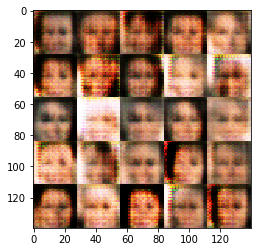

Epoch 1/3... Discriminator Loss: 1.5229... Generator Loss: 0.7032


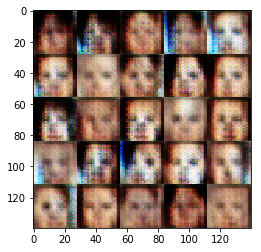

Epoch 1/3... Discriminator Loss: 1.3637... Generator Loss: 0.8977


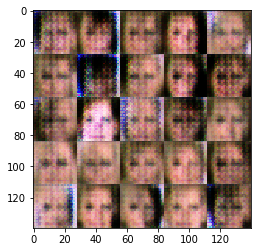

Epoch 1/3... Discriminator Loss: 1.6074... Generator Loss: 0.5022


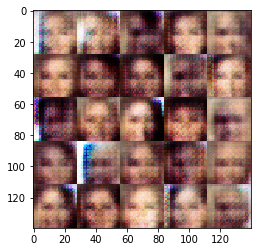

Epoch 1/3... Discriminator Loss: 1.4496... Generator Loss: 0.8208


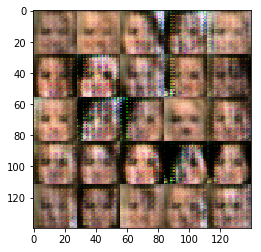

Epoch 1/3... Discriminator Loss: 1.3741... Generator Loss: 0.7203


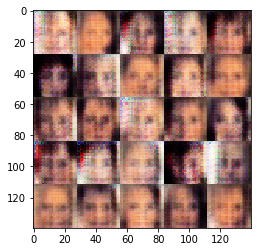

Epoch 1/3... Discriminator Loss: 1.4071... Generator Loss: 0.6495


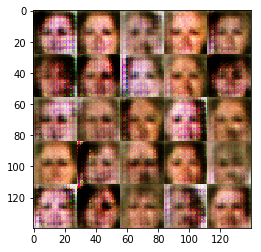

Epoch 1/3... Discriminator Loss: 1.6948... Generator Loss: 0.5125


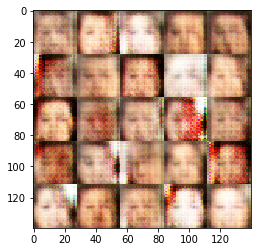

Epoch 1/3... Discriminator Loss: 1.3211... Generator Loss: 0.7414


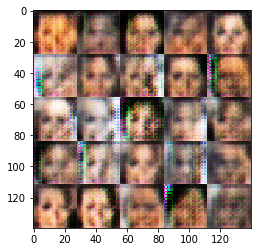

Epoch 1/3... Discriminator Loss: 1.4310... Generator Loss: 0.5833


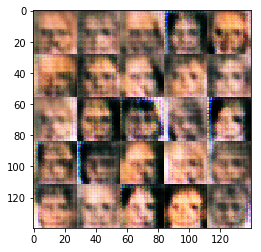

Epoch 1/3... Discriminator Loss: 1.6937... Generator Loss: 0.5532


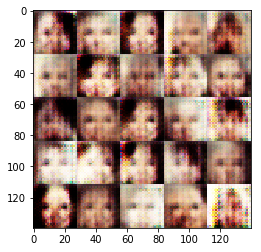

Epoch 1/3... Discriminator Loss: 1.6097... Generator Loss: 0.6217


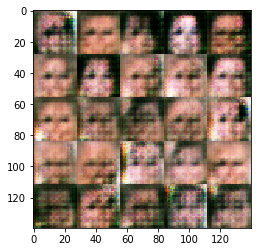

Epoch 1/3... Discriminator Loss: 1.3337... Generator Loss: 0.7804


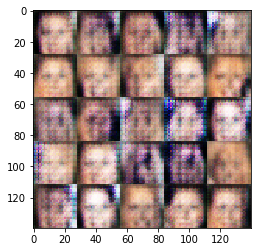

Epoch 1/3... Discriminator Loss: 1.3804... Generator Loss: 0.6978


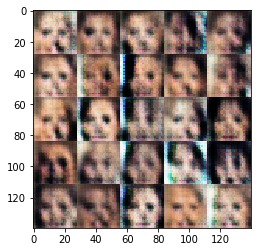

Epoch 1/3... Discriminator Loss: 1.4296... Generator Loss: 0.8331


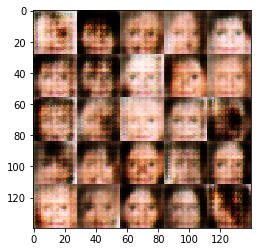

Epoch 1/3... Discriminator Loss: 1.4059... Generator Loss: 0.6579


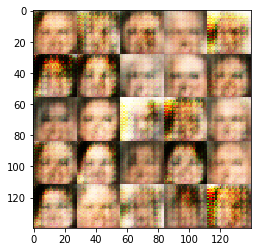

Epoch 1/3... Discriminator Loss: 1.6312... Generator Loss: 1.0170


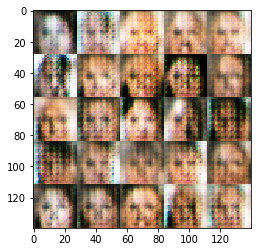

Epoch 1/3... Discriminator Loss: 1.8239... Generator Loss: 0.5607


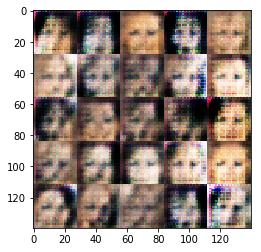

Epoch 1/3... Discriminator Loss: 1.3960... Generator Loss: 0.9018


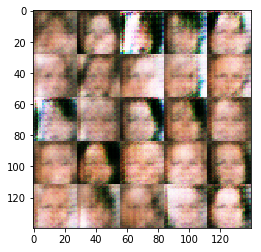

Epoch 1/3... Discriminator Loss: 1.2807... Generator Loss: 0.8320


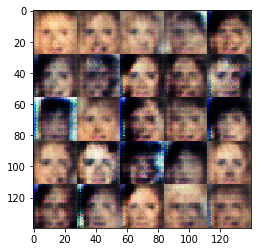

Epoch 1/3... Discriminator Loss: 1.4981... Generator Loss: 0.7204


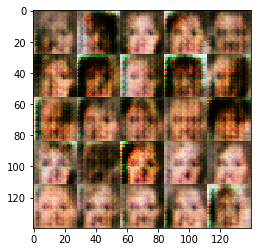

Epoch 1/3... Discriminator Loss: 1.6200... Generator Loss: 0.5314


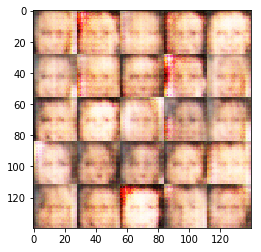

Epoch 1/3... Discriminator Loss: 1.3572... Generator Loss: 0.7468


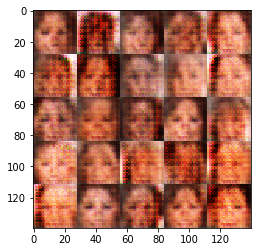

Epoch 1/3... Discriminator Loss: 1.5552... Generator Loss: 0.6067


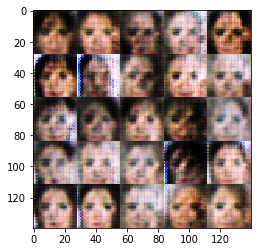

Epoch 1/3... Discriminator Loss: 1.3569... Generator Loss: 0.8440


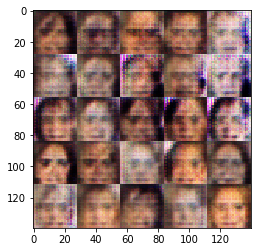

Epoch 1/3... Discriminator Loss: 1.4985... Generator Loss: 0.7107


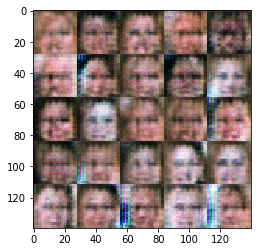

Epoch 1/3... Discriminator Loss: 1.3045... Generator Loss: 0.7142


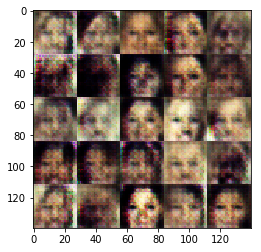

Epoch 1/3... Discriminator Loss: 1.4052... Generator Loss: 0.7921


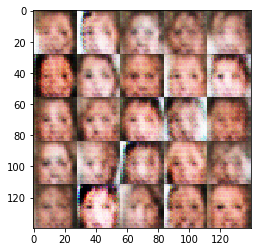

Epoch 1/3... Discriminator Loss: 1.3848... Generator Loss: 0.7383


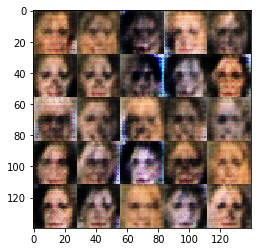

Epoch 1/3... Discriminator Loss: 1.5624... Generator Loss: 0.8288


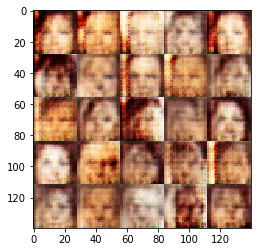

Epoch 1/3... Discriminator Loss: 1.3906... Generator Loss: 0.8810


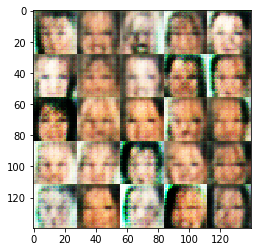

Epoch 1/3... Discriminator Loss: 1.6438... Generator Loss: 0.4400


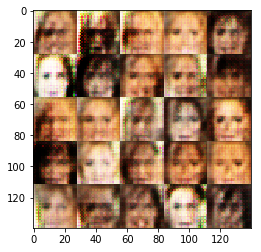

Epoch 1/3... Discriminator Loss: 1.3165... Generator Loss: 0.5857


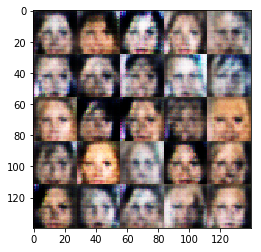

Epoch 1/3... Discriminator Loss: 1.3548... Generator Loss: 0.8293


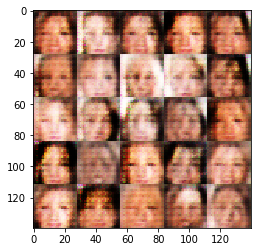

Epoch 1/3... Discriminator Loss: 1.4459... Generator Loss: 0.7263


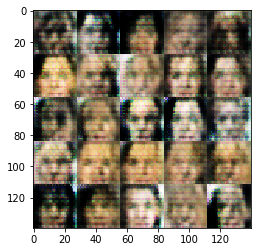

Epoch 1/3... Discriminator Loss: 1.3998... Generator Loss: 0.8260


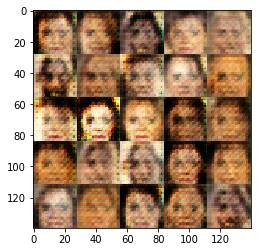

Epoch 1/3... Discriminator Loss: 1.6017... Generator Loss: 0.8930


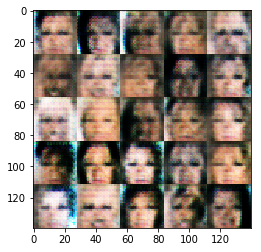

Epoch 1/3... Discriminator Loss: 1.5264... Generator Loss: 0.5820


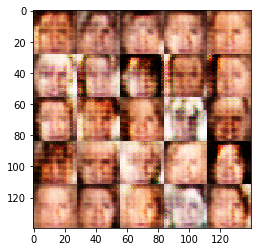

Epoch 1/3... Discriminator Loss: 1.2249... Generator Loss: 0.6640


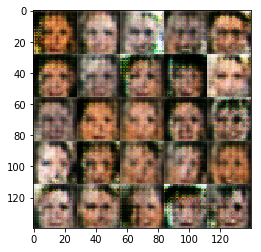

Epoch 1/3... Discriminator Loss: 1.3335... Generator Loss: 1.3309


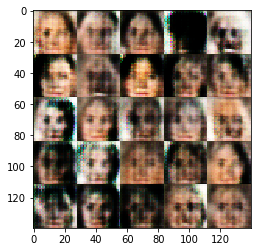

Epoch 1/3... Discriminator Loss: 1.4420... Generator Loss: 0.7622


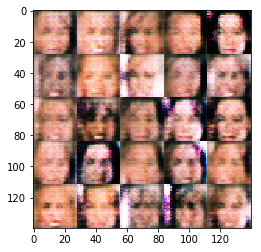

Epoch 1/3... Discriminator Loss: 1.4682... Generator Loss: 0.7022


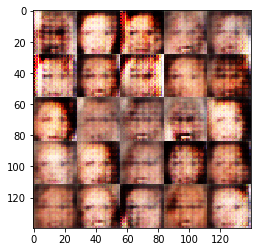

Epoch 1/3... Discriminator Loss: 1.4063... Generator Loss: 0.7961


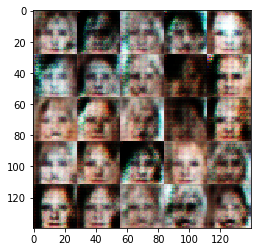

Epoch 1/3... Discriminator Loss: 1.3462... Generator Loss: 0.8383


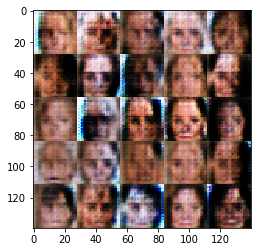

Epoch 1/3... Discriminator Loss: 1.4140... Generator Loss: 0.7240


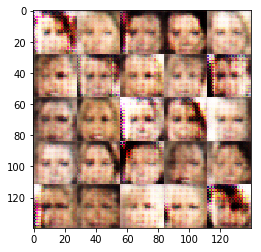

Epoch 1/3... Discriminator Loss: 1.3894... Generator Loss: 0.8989


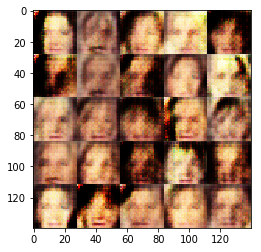

Epoch 1/3... Discriminator Loss: 1.2137... Generator Loss: 0.6555


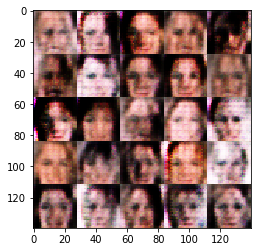

Epoch 1/3... Discriminator Loss: 1.8925... Generator Loss: 0.5430


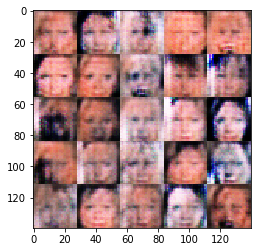

Epoch 1/3... Discriminator Loss: 1.3725... Generator Loss: 0.6147


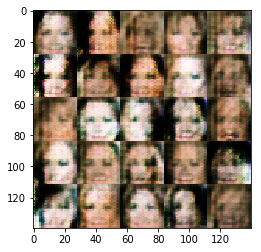

Epoch 1/3... Discriminator Loss: 1.3716... Generator Loss: 0.6926


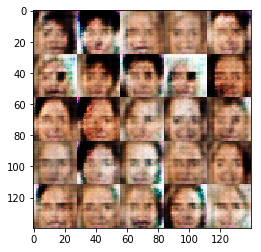

Epoch 1/3... Discriminator Loss: 1.4312... Generator Loss: 0.5951


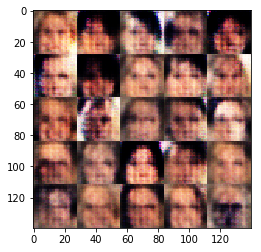

Epoch 1/3... Discriminator Loss: 1.3932... Generator Loss: 0.7174


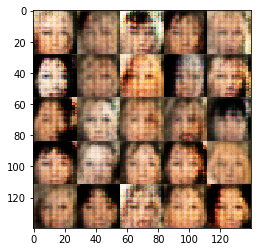

Epoch 1/3... Discriminator Loss: 1.2768... Generator Loss: 1.2216


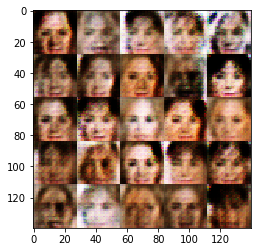

Epoch 1/3... Discriminator Loss: 1.2497... Generator Loss: 0.7035


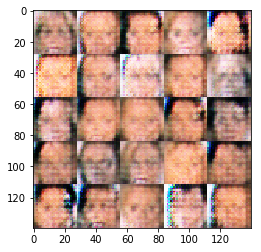

Epoch 1/3... Discriminator Loss: 1.3974... Generator Loss: 0.8771


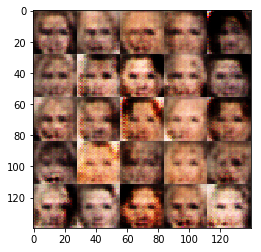

Epoch 1/3... Discriminator Loss: 1.3880... Generator Loss: 0.7753


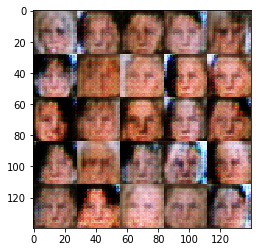

Epoch 1/3... Discriminator Loss: 1.2466... Generator Loss: 0.7955


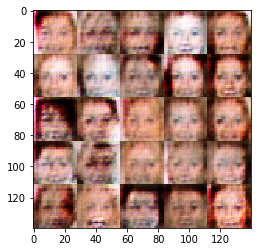

Epoch 1/3... Discriminator Loss: 1.5338... Generator Loss: 0.6231


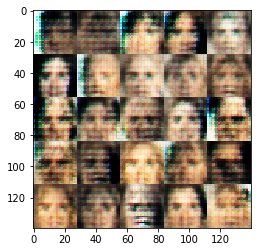

Epoch 1/3... Discriminator Loss: 1.3303... Generator Loss: 0.6223


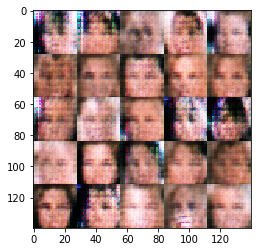

Epoch 1/3... Discriminator Loss: 1.3933... Generator Loss: 0.7631


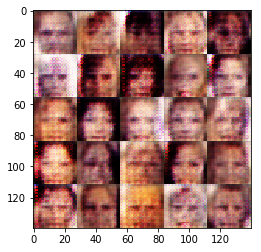

Epoch 1/3... Discriminator Loss: 1.8246... Generator Loss: 1.9511


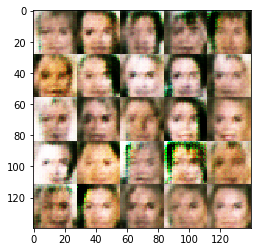

Epoch 1/3... Discriminator Loss: 1.4866... Generator Loss: 0.6660


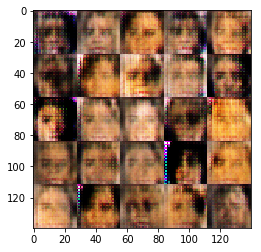

Epoch 1/3... Discriminator Loss: 1.5014... Generator Loss: 0.4716


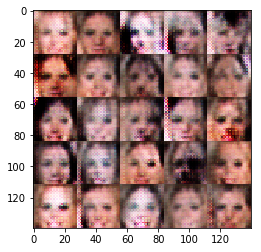

Epoch 1/3... Discriminator Loss: 1.2250... Generator Loss: 0.8542


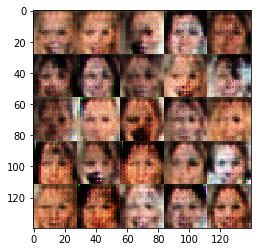

Epoch 1/3... Discriminator Loss: 1.2748... Generator Loss: 0.7752


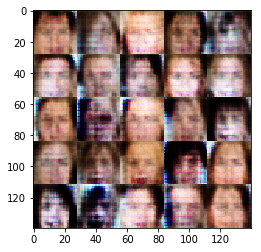

Epoch 1/3... Discriminator Loss: 1.4028... Generator Loss: 0.7010


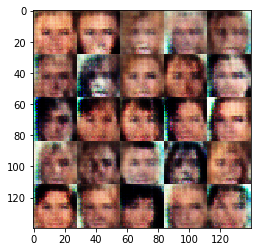

Epoch 1/3... Discriminator Loss: 1.2618... Generator Loss: 0.7349


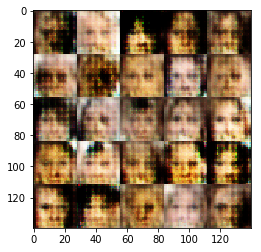

Epoch 1/3... Discriminator Loss: 1.3604... Generator Loss: 0.7783


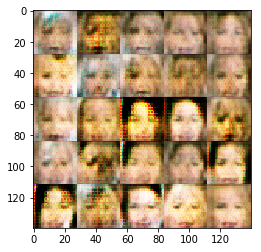

Epoch 1/3... Discriminator Loss: 1.5288... Generator Loss: 0.4596


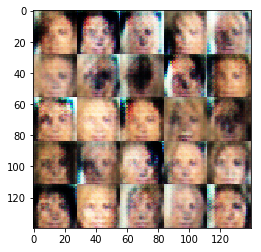

Epoch 1/3... Discriminator Loss: 1.5405... Generator Loss: 0.4683


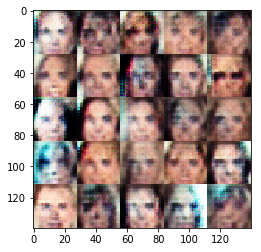

Epoch 1/3... Discriminator Loss: 1.3092... Generator Loss: 0.7668


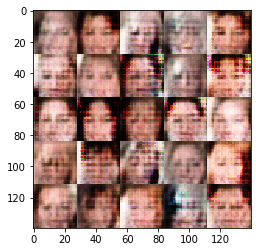

Epoch 1/3... Discriminator Loss: 1.5228... Generator Loss: 0.5601


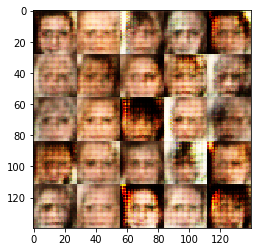

Epoch 1/3... Discriminator Loss: 1.2639... Generator Loss: 0.7979


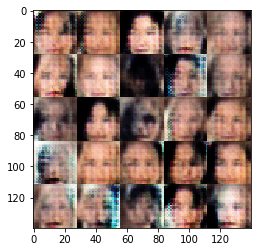

Epoch 1/3... Discriminator Loss: 1.3282... Generator Loss: 0.7952


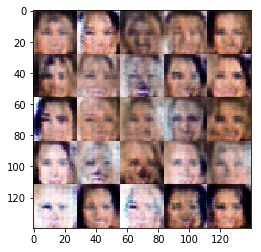

Epoch 1/3... Discriminator Loss: 1.3973... Generator Loss: 0.7087


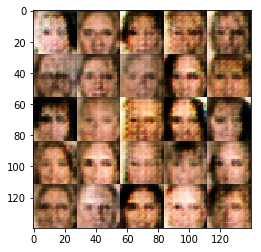

Epoch 1/3... Discriminator Loss: 1.3865... Generator Loss: 0.7818


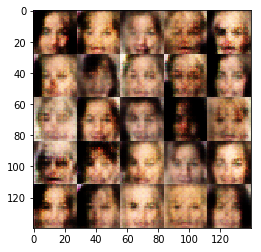

Epoch 1/3... Discriminator Loss: 1.5546... Generator Loss: 0.5016


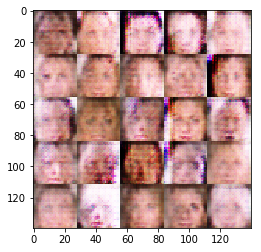

Epoch 1/3... Discriminator Loss: 1.3115... Generator Loss: 0.7035


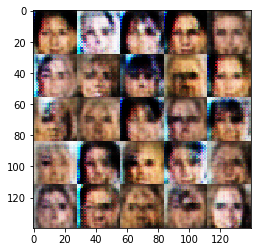

Epoch 1/3... Discriminator Loss: 1.5582... Generator Loss: 0.5494


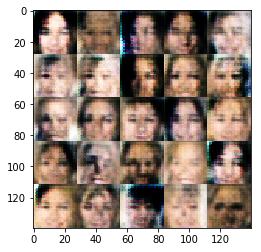

Epoch 1/3... Discriminator Loss: 1.3140... Generator Loss: 0.6881


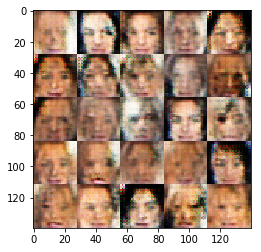

Epoch 1/3... Discriminator Loss: 1.7090... Generator Loss: 0.4441


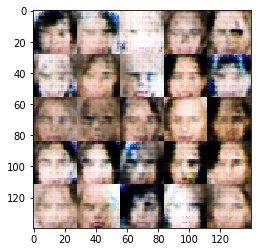

Epoch 1/3... Discriminator Loss: 1.3863... Generator Loss: 0.7322


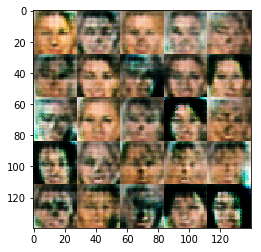

Epoch 1/3... Discriminator Loss: 1.4985... Generator Loss: 0.6231


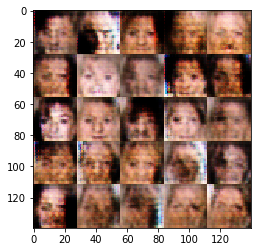

Epoch 1/3... Discriminator Loss: 1.2159... Generator Loss: 0.8084


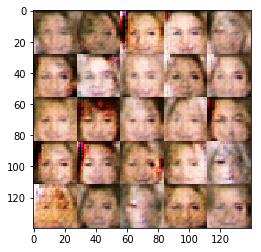

Epoch 1/3... Discriminator Loss: 1.5840... Generator Loss: 0.3957


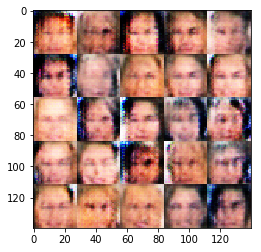

Epoch 1/3... Discriminator Loss: 1.3636... Generator Loss: 0.7743


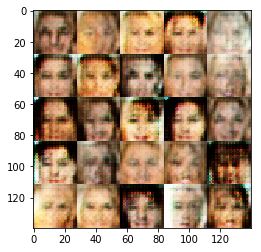

Epoch 1/3... Discriminator Loss: 1.4637... Generator Loss: 0.6619


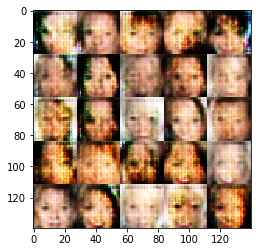

Epoch 1/3... Discriminator Loss: 1.4142... Generator Loss: 0.7583


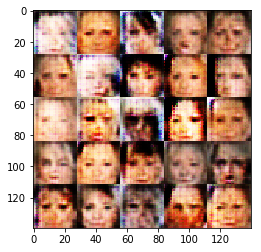

Epoch 1/3... Discriminator Loss: 1.3907... Generator Loss: 0.7757


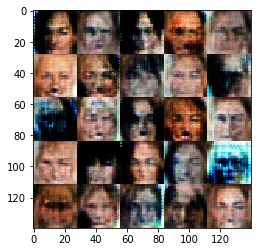

Epoch 1/3... Discriminator Loss: 1.5490... Generator Loss: 0.7163


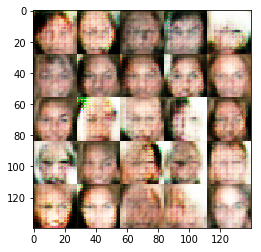

Epoch 1/3... Discriminator Loss: 1.3080... Generator Loss: 0.4832


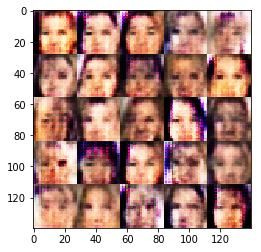

Epoch 1/3... Discriminator Loss: 1.4864... Generator Loss: 0.6048


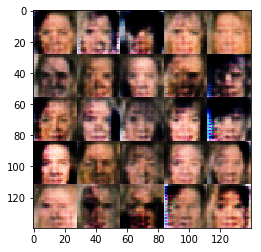

Epoch 1/3... Discriminator Loss: 1.3533... Generator Loss: 0.7268


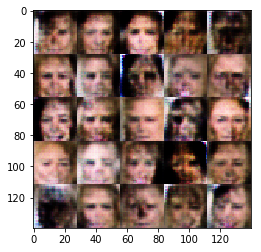

Epoch 1/3... Discriminator Loss: 1.3882... Generator Loss: 0.6577


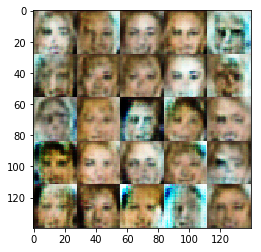

Epoch 1/3... Discriminator Loss: 1.4022... Generator Loss: 0.6991


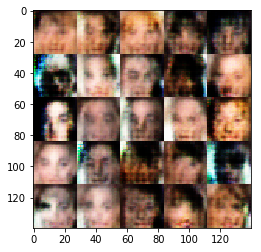

Epoch 1/3... Discriminator Loss: 1.2587... Generator Loss: 0.6847


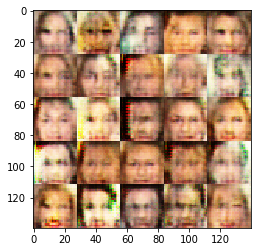

Epoch 1/3... Discriminator Loss: 1.3798... Generator Loss: 0.6810


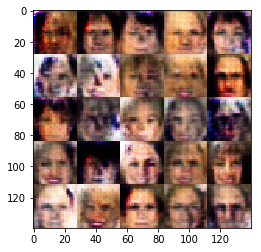

Epoch 1/3... Discriminator Loss: 1.2927... Generator Loss: 0.7474


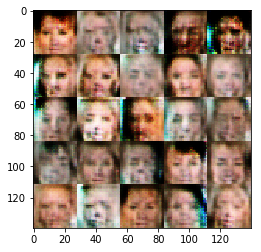

Epoch 1/3... Discriminator Loss: 1.5269... Generator Loss: 0.4415


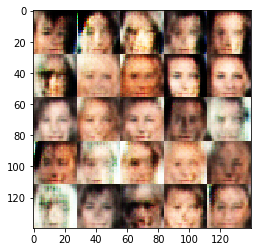

Epoch 1/3... Discriminator Loss: 1.2948... Generator Loss: 0.7749


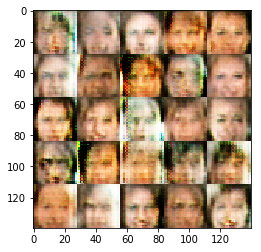

Epoch 1/3... Discriminator Loss: 1.4322... Generator Loss: 0.8416


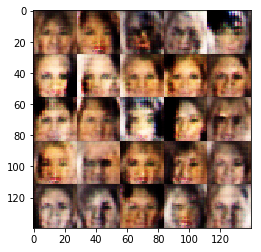

Epoch 1/3... Discriminator Loss: 1.3532... Generator Loss: 0.7615


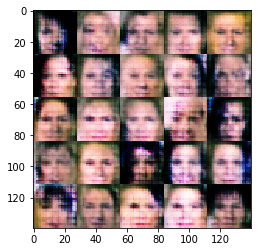

Epoch 1/3... Discriminator Loss: 1.3280... Generator Loss: 0.5381


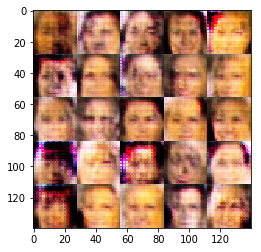

Epoch 1/3... Discriminator Loss: 1.4421... Generator Loss: 0.7933


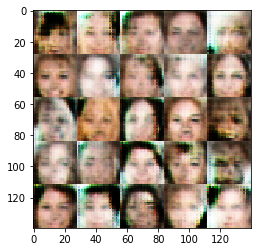

Epoch 1/3... Discriminator Loss: 1.3478... Generator Loss: 0.7590


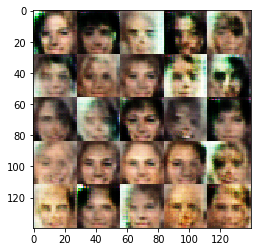

Epoch 1/3... Discriminator Loss: 1.3917... Generator Loss: 0.7226


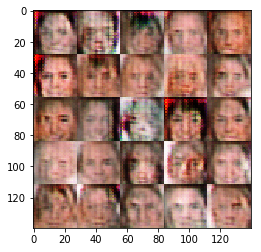

Epoch 1/3... Discriminator Loss: 1.3987... Generator Loss: 0.7417


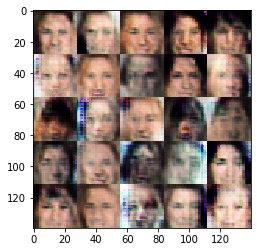

Epoch 1/3... Discriminator Loss: 1.2408... Generator Loss: 0.7643


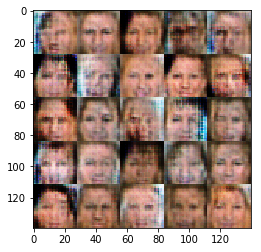

Epoch 1/3... Discriminator Loss: 1.5030... Generator Loss: 0.6955


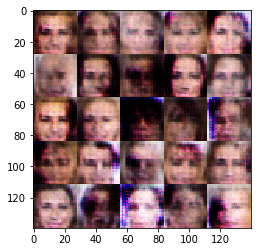

Epoch 1/3... Discriminator Loss: 1.3998... Generator Loss: 0.7777


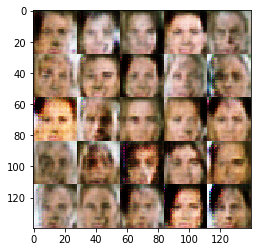

Epoch 1/3... Discriminator Loss: 1.5799... Generator Loss: 0.9515


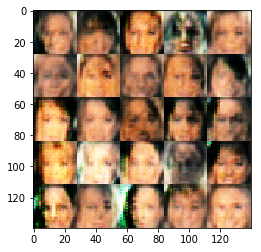

Epoch 1/3... Discriminator Loss: 1.3915... Generator Loss: 0.6058


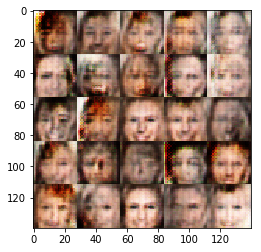

Epoch 1/3... Discriminator Loss: 1.7665... Generator Loss: 1.2213


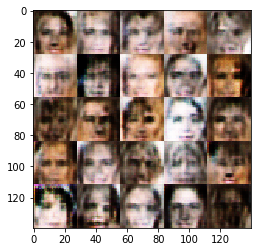

Epoch 1/3... Discriminator Loss: 1.3610... Generator Loss: 0.7317


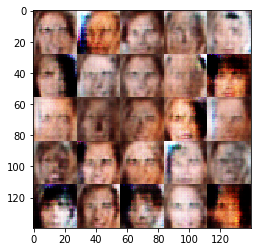

Epoch 1/3... Discriminator Loss: 1.3909... Generator Loss: 0.6550


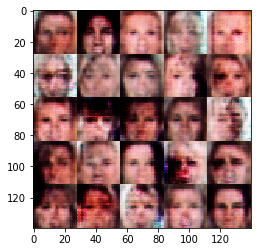

Epoch 1/3... Discriminator Loss: 1.6633... Generator Loss: 1.1786


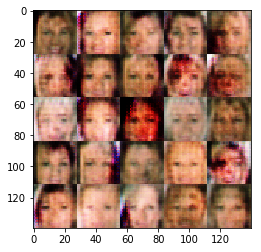

Epoch 1/3... Discriminator Loss: 1.3631... Generator Loss: 0.7456


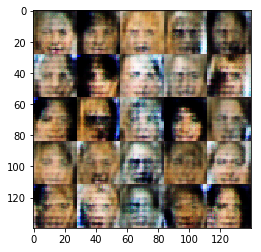

Epoch 1/3... Discriminator Loss: 1.9249... Generator Loss: 0.3009


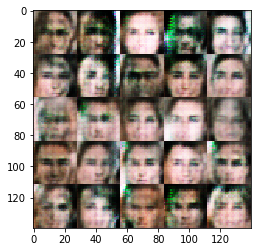

Epoch 1/3... Discriminator Loss: 1.2154... Generator Loss: 0.6969


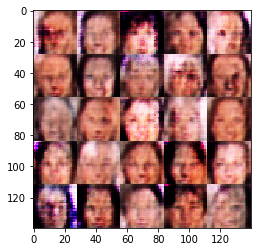

Epoch 1/3... Discriminator Loss: 1.2878... Generator Loss: 0.7945


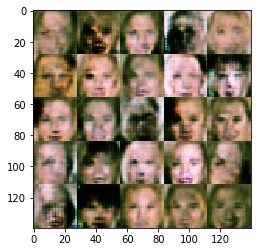

Epoch 2/3... Discriminator Loss: 1.2842... Generator Loss: 0.7277


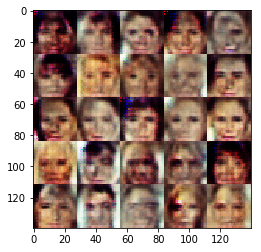

Epoch 2/3... Discriminator Loss: 1.4448... Generator Loss: 0.8474


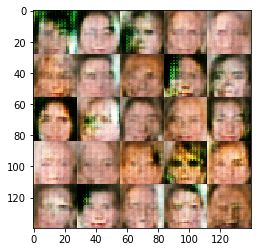

Epoch 2/3... Discriminator Loss: 1.4524... Generator Loss: 0.7858


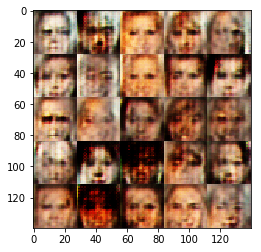

Epoch 2/3... Discriminator Loss: 1.2765... Generator Loss: 0.8676


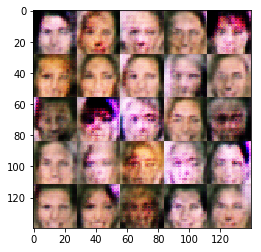

Epoch 2/3... Discriminator Loss: 1.3617... Generator Loss: 0.6956


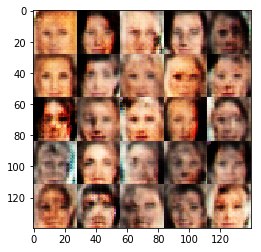

Epoch 2/3... Discriminator Loss: 1.3511... Generator Loss: 0.8211


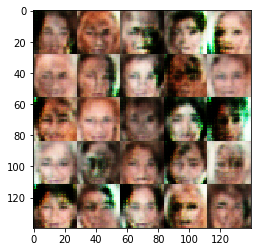

Epoch 2/3... Discriminator Loss: 1.3378... Generator Loss: 0.7283


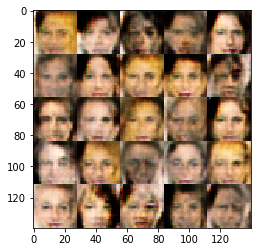

Epoch 2/3... Discriminator Loss: 1.5150... Generator Loss: 0.5963


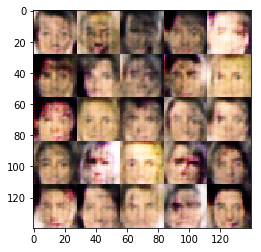

Epoch 2/3... Discriminator Loss: 1.4945... Generator Loss: 0.9689


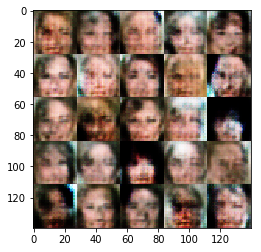

Epoch 2/3... Discriminator Loss: 1.5138... Generator Loss: 0.8176


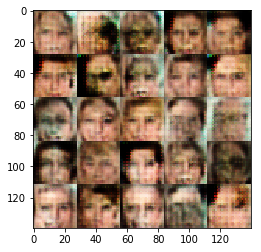

Epoch 2/3... Discriminator Loss: 1.5501... Generator Loss: 0.6382


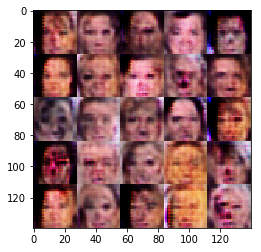

Epoch 2/3... Discriminator Loss: 1.3092... Generator Loss: 0.7072


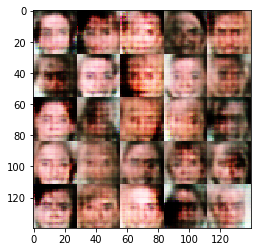

Epoch 2/3... Discriminator Loss: 1.5111... Generator Loss: 0.7307


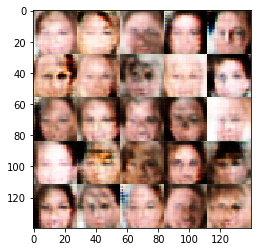

Epoch 2/3... Discriminator Loss: 1.4370... Generator Loss: 0.6954


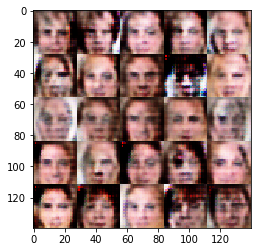

Epoch 2/3... Discriminator Loss: 1.7899... Generator Loss: 0.3505


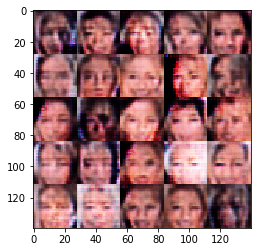

Epoch 2/3... Discriminator Loss: 1.9276... Generator Loss: 0.3637


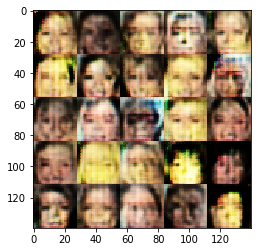

Epoch 2/3... Discriminator Loss: 1.1204... Generator Loss: 0.8834


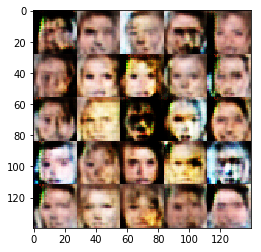

Epoch 2/3... Discriminator Loss: 1.2214... Generator Loss: 0.8136


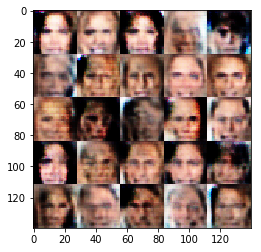

Epoch 2/3... Discriminator Loss: 1.5185... Generator Loss: 0.7416


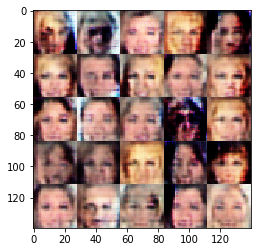

Epoch 2/3... Discriminator Loss: 1.4078... Generator Loss: 0.7224


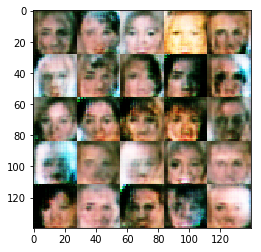

Epoch 2/3... Discriminator Loss: 1.2090... Generator Loss: 0.7301


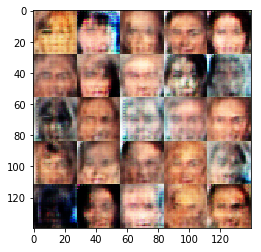

Epoch 2/3... Discriminator Loss: 1.3292... Generator Loss: 0.6308


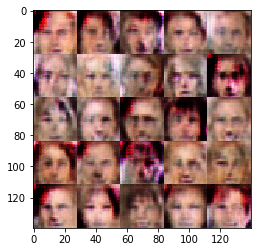

Epoch 2/3... Discriminator Loss: 1.2047... Generator Loss: 0.7985


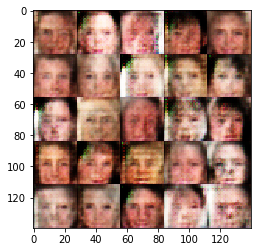

Epoch 2/3... Discriminator Loss: 1.5254... Generator Loss: 0.6614


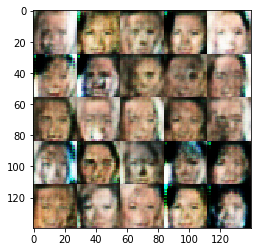

Epoch 2/3... Discriminator Loss: 1.1597... Generator Loss: 0.7767


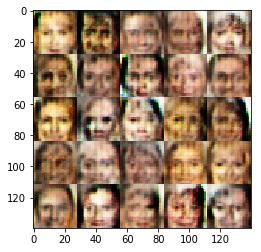

Epoch 2/3... Discriminator Loss: 1.4646... Generator Loss: 0.6986


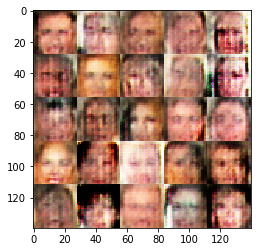

Epoch 2/3... Discriminator Loss: 1.2021... Generator Loss: 0.8794


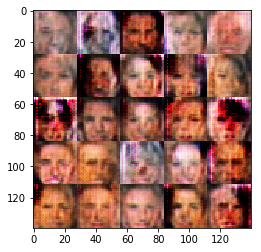

Epoch 2/3... Discriminator Loss: 1.4873... Generator Loss: 0.6144


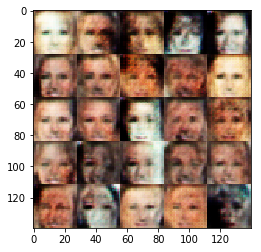

Epoch 2/3... Discriminator Loss: 1.3861... Generator Loss: 0.7478


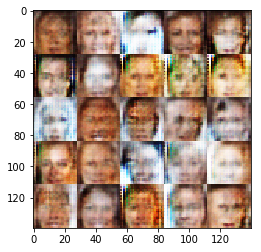

Epoch 2/3... Discriminator Loss: 1.2880... Generator Loss: 0.8536


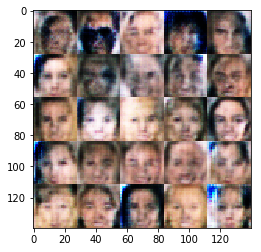

Epoch 2/3... Discriminator Loss: 1.3599... Generator Loss: 0.6553


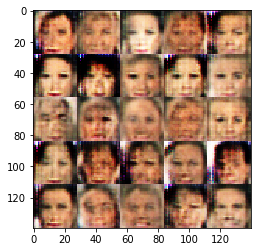

Epoch 2/3... Discriminator Loss: 1.4298... Generator Loss: 0.6959


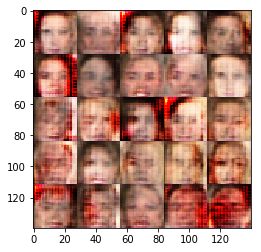

Epoch 2/3... Discriminator Loss: 1.2512... Generator Loss: 0.8502


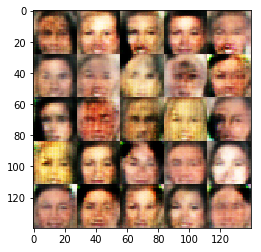

Epoch 2/3... Discriminator Loss: 1.4076... Generator Loss: 0.9916


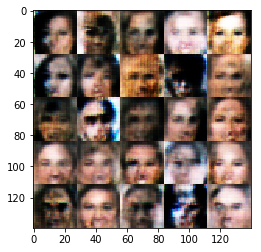

Epoch 2/3... Discriminator Loss: 1.3742... Generator Loss: 0.9622


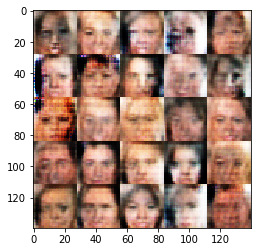

Epoch 2/3... Discriminator Loss: 1.4662... Generator Loss: 0.6122


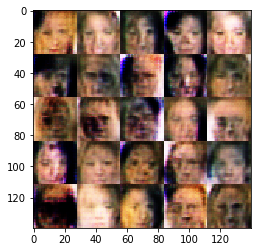

Epoch 2/3... Discriminator Loss: 1.3970... Generator Loss: 0.6471


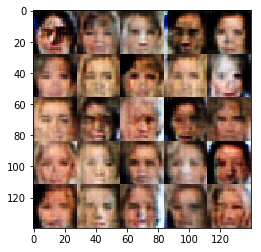

Epoch 2/3... Discriminator Loss: 1.5851... Generator Loss: 0.6965


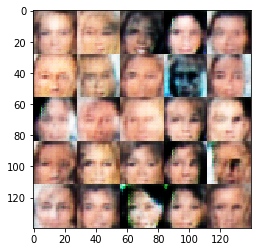

Epoch 2/3... Discriminator Loss: 1.4545... Generator Loss: 0.6709


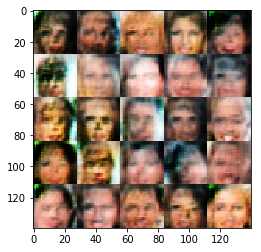

Epoch 2/3... Discriminator Loss: 1.3430... Generator Loss: 0.8137


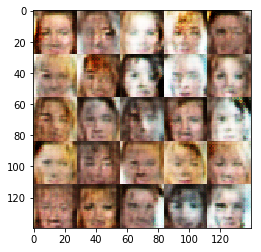

Epoch 2/3... Discriminator Loss: 1.6149... Generator Loss: 0.4860


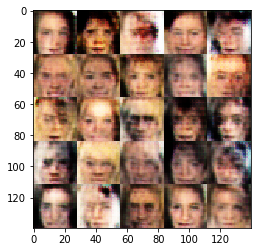

Epoch 2/3... Discriminator Loss: 1.4116... Generator Loss: 0.7340


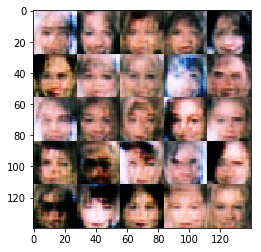

Epoch 2/3... Discriminator Loss: 1.2306... Generator Loss: 0.7383


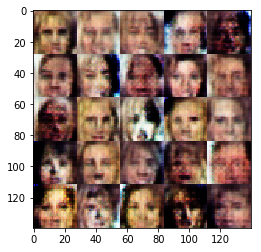

Epoch 2/3... Discriminator Loss: 1.3671... Generator Loss: 0.6054


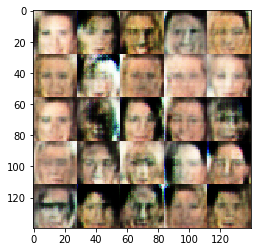

Epoch 2/3... Discriminator Loss: 1.3305... Generator Loss: 0.9079


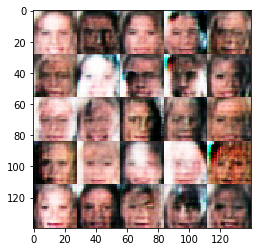

Epoch 2/3... Discriminator Loss: 1.4344... Generator Loss: 0.7165


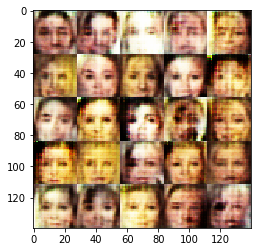

Epoch 2/3... Discriminator Loss: 1.2081... Generator Loss: 0.9832


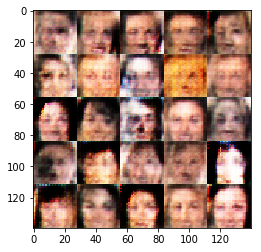

Epoch 2/3... Discriminator Loss: 1.2767... Generator Loss: 0.6249


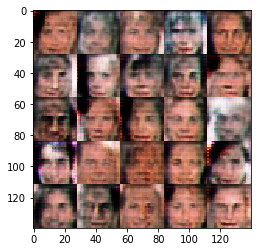

Epoch 2/3... Discriminator Loss: 1.5184... Generator Loss: 0.7997


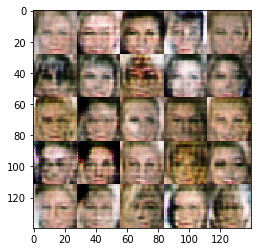

Epoch 2/3... Discriminator Loss: 1.4045... Generator Loss: 0.7122


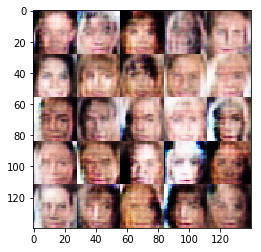

Epoch 2/3... Discriminator Loss: 1.4591... Generator Loss: 0.8845


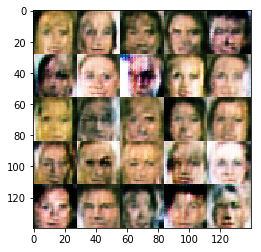

Epoch 2/3... Discriminator Loss: 1.4238... Generator Loss: 0.7995


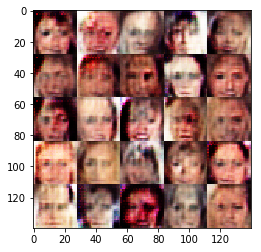

Epoch 2/3... Discriminator Loss: 1.3331... Generator Loss: 0.7750


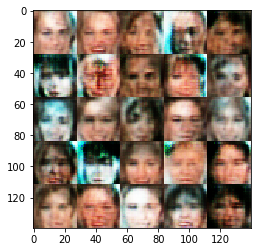

Epoch 2/3... Discriminator Loss: 1.4299... Generator Loss: 0.6373


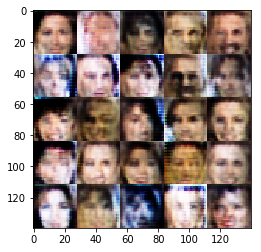

Epoch 2/3... Discriminator Loss: 1.2782... Generator Loss: 0.9059


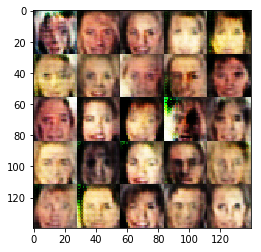

Epoch 2/3... Discriminator Loss: 1.4842... Generator Loss: 0.9002


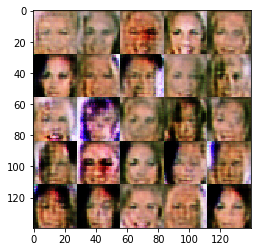

Epoch 2/3... Discriminator Loss: 1.3255... Generator Loss: 0.7318


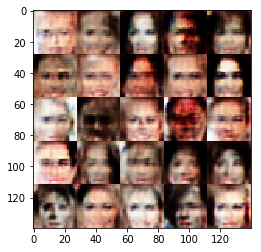

Epoch 2/3... Discriminator Loss: 1.4223... Generator Loss: 0.5963


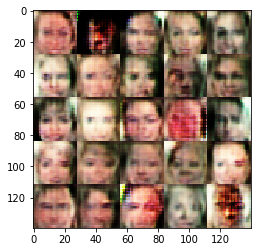

Epoch 2/3... Discriminator Loss: 1.2792... Generator Loss: 1.1564


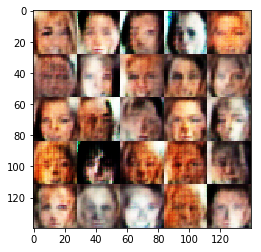

Epoch 2/3... Discriminator Loss: 1.4100... Generator Loss: 0.6345


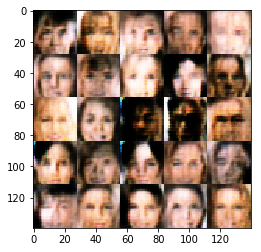

Epoch 2/3... Discriminator Loss: 1.4409... Generator Loss: 0.6635


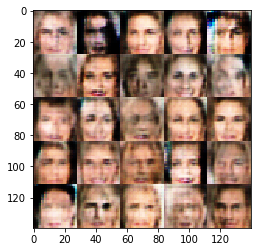

Epoch 2/3... Discriminator Loss: 1.6158... Generator Loss: 0.4987


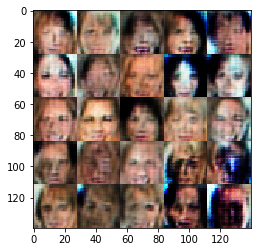

Epoch 2/3... Discriminator Loss: 1.4358... Generator Loss: 1.1168


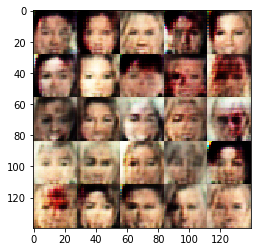

Epoch 2/3... Discriminator Loss: 1.3032... Generator Loss: 0.7587


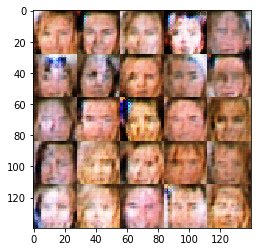

Epoch 2/3... Discriminator Loss: 1.3444... Generator Loss: 0.6356


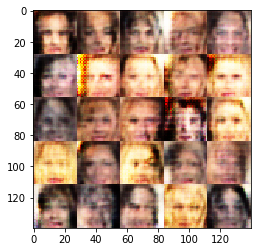

Epoch 2/3... Discriminator Loss: 1.3997... Generator Loss: 0.6609


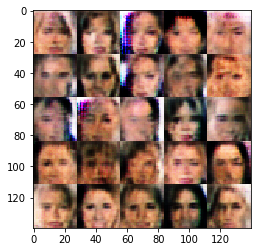

Epoch 2/3... Discriminator Loss: 1.1719... Generator Loss: 0.6964


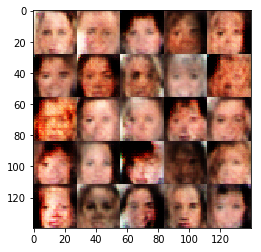

Epoch 2/3... Discriminator Loss: 1.2945... Generator Loss: 0.8674


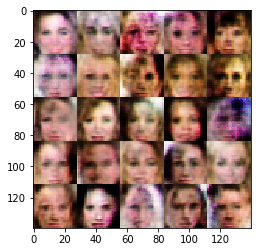

Epoch 2/3... Discriminator Loss: 1.3339... Generator Loss: 0.8945


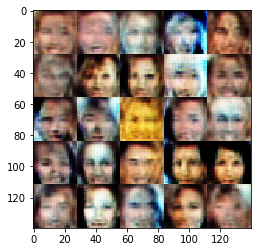

Epoch 2/3... Discriminator Loss: 1.5868... Generator Loss: 0.4678


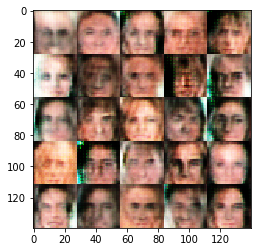

Epoch 2/3... Discriminator Loss: 1.3163... Generator Loss: 0.9385


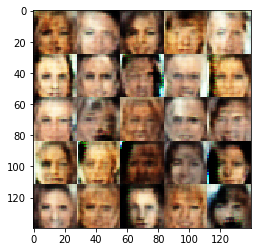

Epoch 2/3... Discriminator Loss: 1.4083... Generator Loss: 0.7626


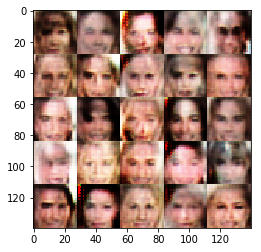

Epoch 2/3... Discriminator Loss: 1.1184... Generator Loss: 0.9122


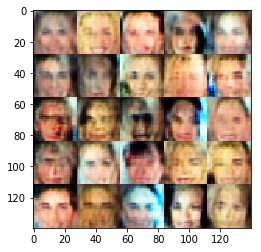

Epoch 2/3... Discriminator Loss: 1.1205... Generator Loss: 0.7659


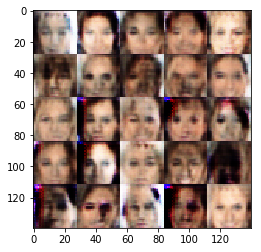

Epoch 2/3... Discriminator Loss: 1.4408... Generator Loss: 0.5614


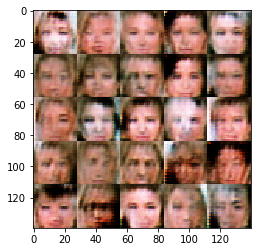

Epoch 2/3... Discriminator Loss: 1.3337... Generator Loss: 0.7121


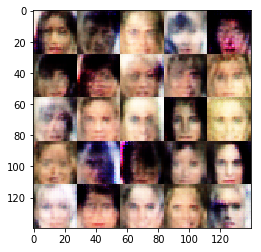

Epoch 2/3... Discriminator Loss: 1.1924... Generator Loss: 0.8924


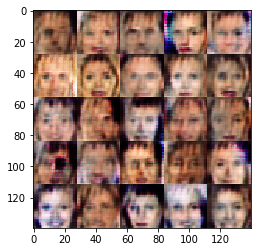

Epoch 2/3... Discriminator Loss: 1.4976... Generator Loss: 0.8002


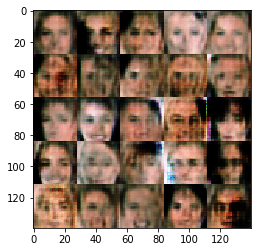

Epoch 2/3... Discriminator Loss: 1.4388... Generator Loss: 0.7401


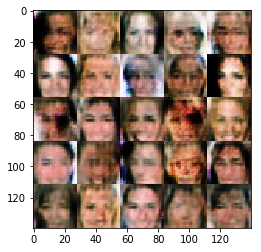

Epoch 2/3... Discriminator Loss: 1.1648... Generator Loss: 0.7616


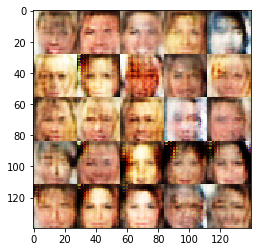

Epoch 2/3... Discriminator Loss: 1.4211... Generator Loss: 0.7176


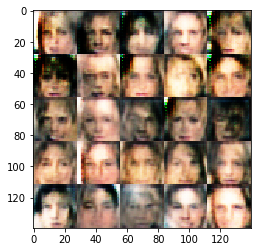

Epoch 2/3... Discriminator Loss: 1.4413... Generator Loss: 0.9130


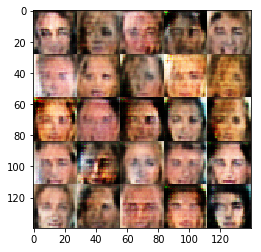

Epoch 2/3... Discriminator Loss: 1.3521... Generator Loss: 0.7894


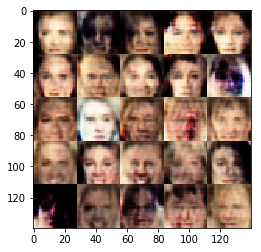

Epoch 2/3... Discriminator Loss: 1.2992... Generator Loss: 0.6705


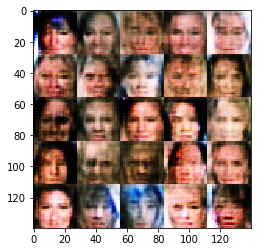

Epoch 2/3... Discriminator Loss: 1.8687... Generator Loss: 2.1001


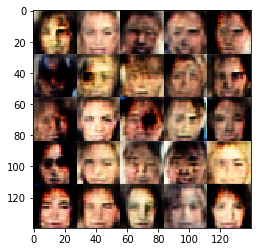

Epoch 2/3... Discriminator Loss: 1.4419... Generator Loss: 0.7066


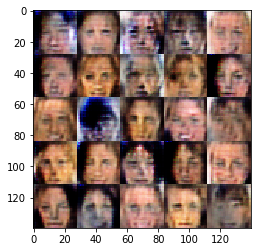

Epoch 2/3... Discriminator Loss: 1.3511... Generator Loss: 0.7055


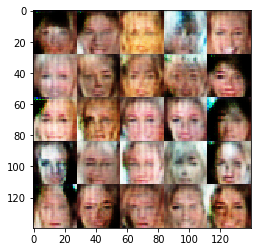

Epoch 2/3... Discriminator Loss: 1.3809... Generator Loss: 0.8490


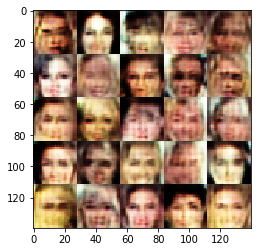

Epoch 2/3... Discriminator Loss: 1.3549... Generator Loss: 0.6411


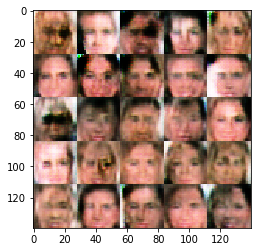

Epoch 2/3... Discriminator Loss: 1.4889... Generator Loss: 0.7578


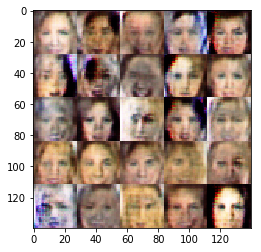

Epoch 2/3... Discriminator Loss: 1.3858... Generator Loss: 0.6365


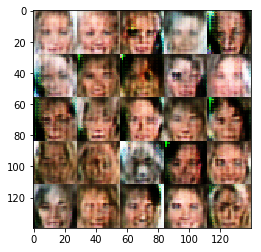

Epoch 2/3... Discriminator Loss: 1.7461... Generator Loss: 0.4762


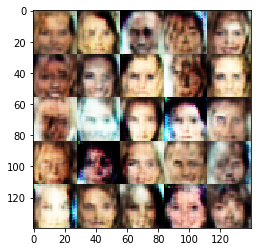

Epoch 2/3... Discriminator Loss: 1.1946... Generator Loss: 0.8395


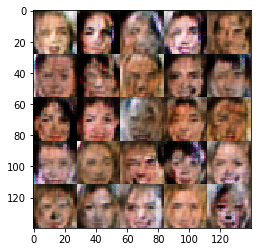

Epoch 2/3... Discriminator Loss: 1.6095... Generator Loss: 0.9775


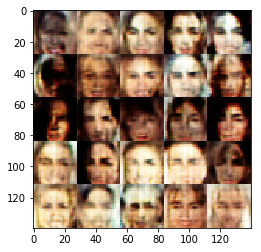

Epoch 2/3... Discriminator Loss: 1.5755... Generator Loss: 0.5443


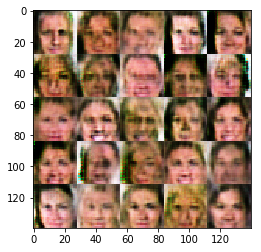

Epoch 2/3... Discriminator Loss: 1.5442... Generator Loss: 0.6256


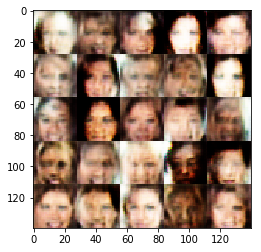

Epoch 2/3... Discriminator Loss: 1.2044... Generator Loss: 0.8870


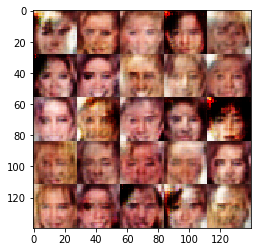

Epoch 2/3... Discriminator Loss: 1.4317... Generator Loss: 0.8095


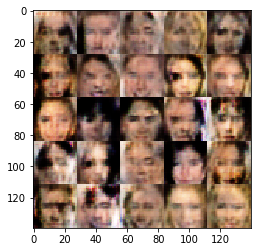

Epoch 2/3... Discriminator Loss: 1.1938... Generator Loss: 0.8372


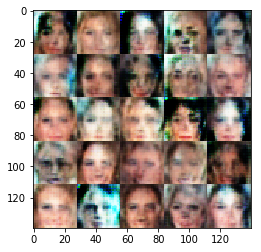

Epoch 2/3... Discriminator Loss: 1.3156... Generator Loss: 0.6559


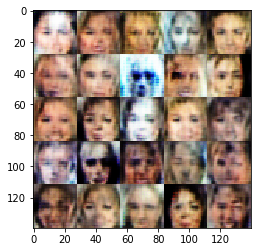

Epoch 2/3... Discriminator Loss: 1.3823... Generator Loss: 0.5533


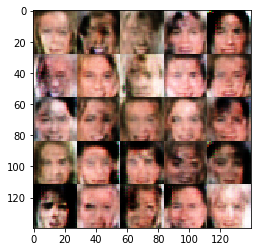

Epoch 2/3... Discriminator Loss: 1.2546... Generator Loss: 0.8971


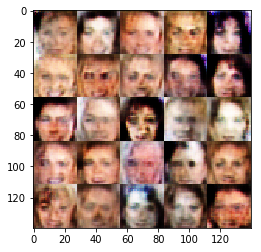

Epoch 2/3... Discriminator Loss: 1.2121... Generator Loss: 0.7988


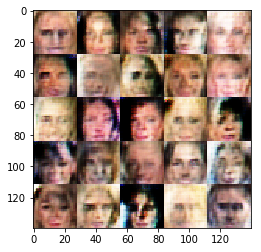

Epoch 2/3... Discriminator Loss: 1.3628... Generator Loss: 0.7797


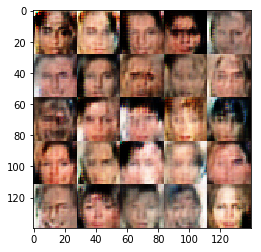

Epoch 2/3... Discriminator Loss: 1.4138... Generator Loss: 0.6116


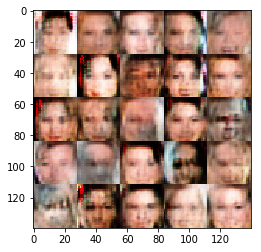

Epoch 2/3... Discriminator Loss: 1.2241... Generator Loss: 0.9034


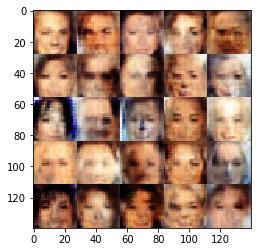

Epoch 2/3... Discriminator Loss: 1.2840... Generator Loss: 0.7811


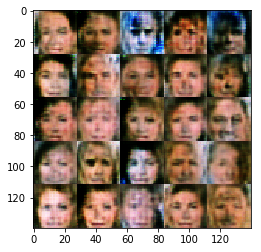

Epoch 2/3... Discriminator Loss: 1.3748... Generator Loss: 0.8099


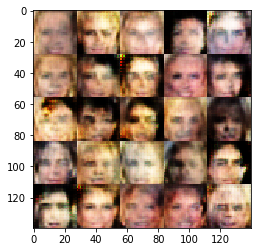

Epoch 2/3... Discriminator Loss: 1.4198... Generator Loss: 0.7141


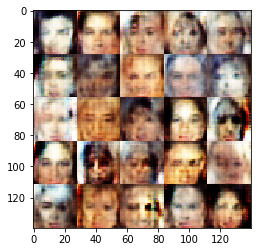

Epoch 2/3... Discriminator Loss: 1.2879... Generator Loss: 0.6961


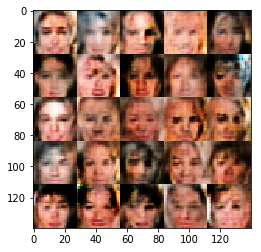

Epoch 2/3... Discriminator Loss: 1.3158... Generator Loss: 0.7657


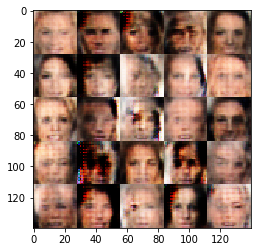

Epoch 2/3... Discriminator Loss: 1.2841... Generator Loss: 0.7311


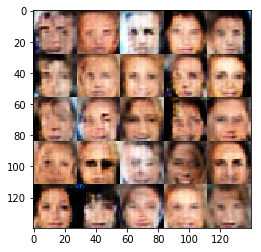

Epoch 2/3... Discriminator Loss: 1.5130... Generator Loss: 1.1723


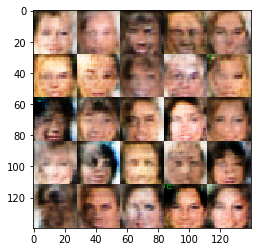

Epoch 2/3... Discriminator Loss: 1.3493... Generator Loss: 0.7526


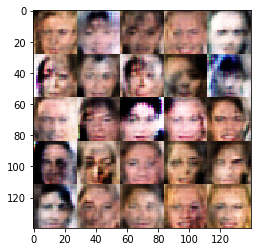

Epoch 2/3... Discriminator Loss: 1.4197... Generator Loss: 0.4450


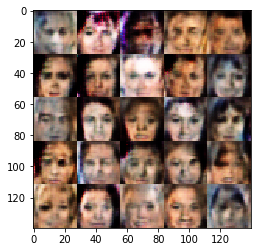

Epoch 2/3... Discriminator Loss: 1.4422... Generator Loss: 0.8475


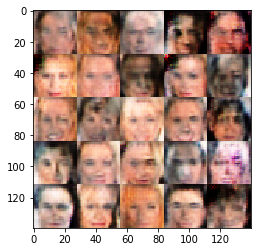

Epoch 2/3... Discriminator Loss: 1.2948... Generator Loss: 0.8030


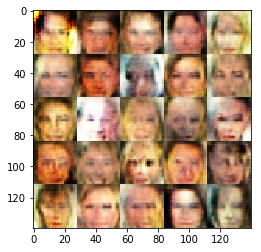

Epoch 2/3... Discriminator Loss: 1.3130... Generator Loss: 0.7244


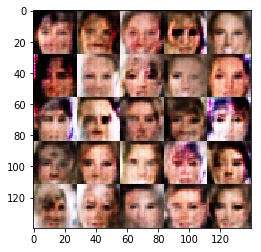

Epoch 2/3... Discriminator Loss: 1.3627... Generator Loss: 0.7553


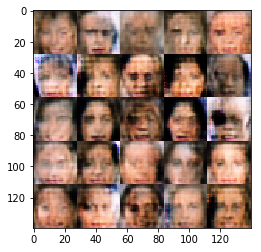

Epoch 2/3... Discriminator Loss: 1.4130... Generator Loss: 0.7725


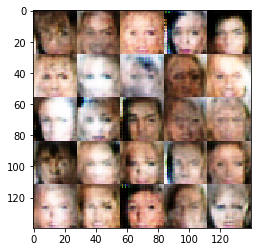

Epoch 2/3... Discriminator Loss: 1.2338... Generator Loss: 0.8319


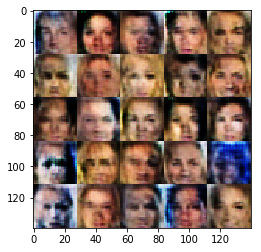

Epoch 2/3... Discriminator Loss: 1.2933... Generator Loss: 0.8695


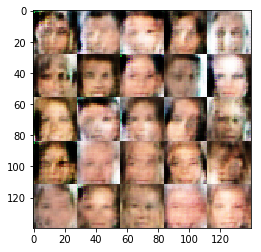

Epoch 2/3... Discriminator Loss: 1.2898... Generator Loss: 0.8189


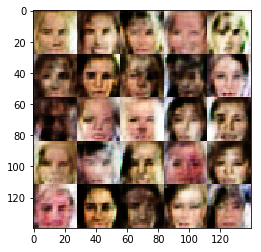

Epoch 2/3... Discriminator Loss: 1.2908... Generator Loss: 0.6669


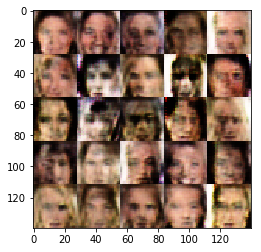

Epoch 2/3... Discriminator Loss: 1.3925... Generator Loss: 0.7092


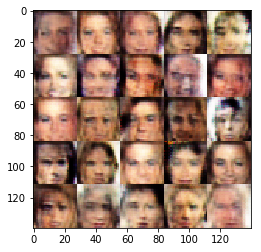

Epoch 2/3... Discriminator Loss: 1.2453... Generator Loss: 0.7339


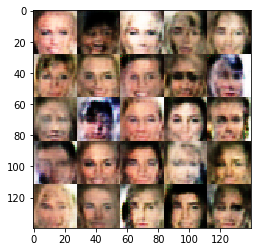

Epoch 2/3... Discriminator Loss: 1.3692... Generator Loss: 0.6534


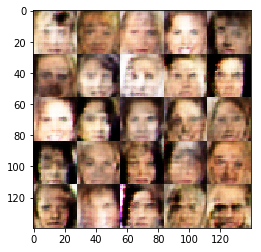

Epoch 2/3... Discriminator Loss: 1.3432... Generator Loss: 0.6440


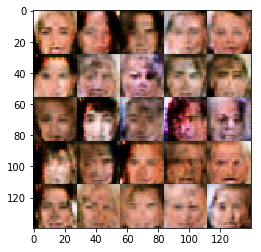

Epoch 2/3... Discriminator Loss: 1.3346... Generator Loss: 0.6466


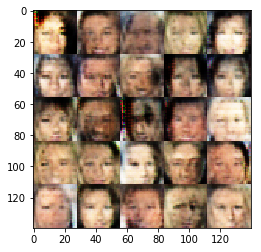

Epoch 2/3... Discriminator Loss: 1.3306... Generator Loss: 0.6730


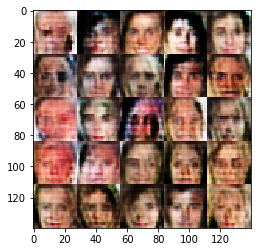

Epoch 2/3... Discriminator Loss: 1.4871... Generator Loss: 0.6903


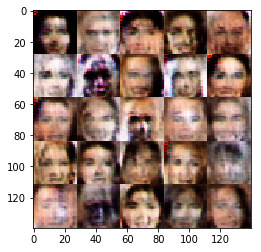

Epoch 2/3... Discriminator Loss: 1.4268... Generator Loss: 0.6330


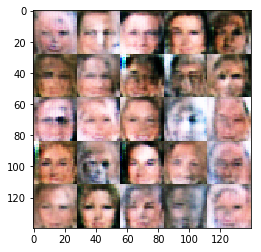

Epoch 2/3... Discriminator Loss: 1.4155... Generator Loss: 0.8944


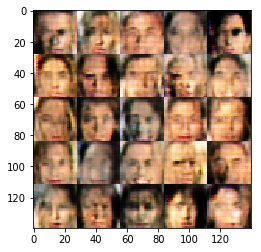

Epoch 2/3... Discriminator Loss: 1.4768... Generator Loss: 0.5560


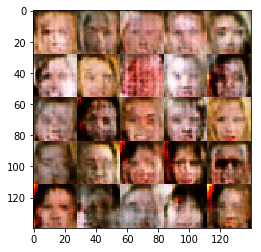

Epoch 2/3... Discriminator Loss: 1.2943... Generator Loss: 0.7474


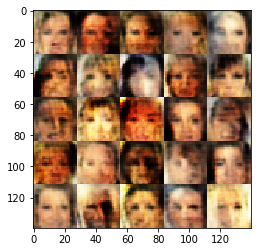

Epoch 2/3... Discriminator Loss: 1.3470... Generator Loss: 0.6994


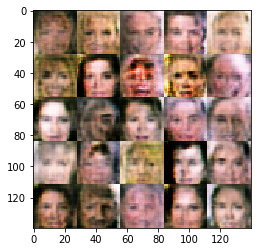

Epoch 2/3... Discriminator Loss: 1.2458... Generator Loss: 0.7842


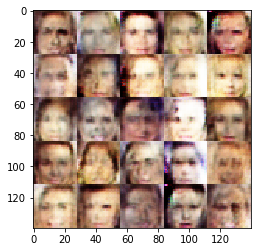

Epoch 2/3... Discriminator Loss: 1.2313... Generator Loss: 0.7838


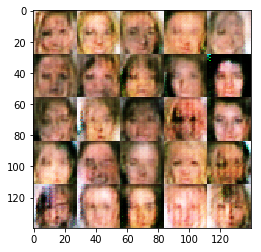

Epoch 2/3... Discriminator Loss: 1.3236... Generator Loss: 0.6283


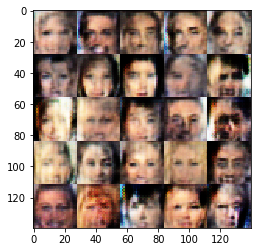

Epoch 2/3... Discriminator Loss: 1.5230... Generator Loss: 0.7424


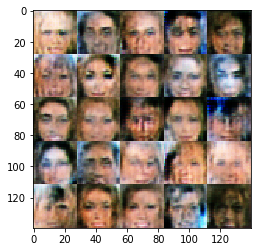

Epoch 2/3... Discriminator Loss: 1.3111... Generator Loss: 0.6630


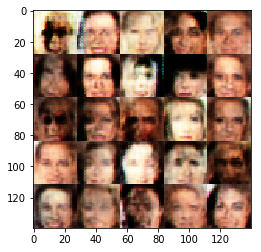

Epoch 2/3... Discriminator Loss: 1.3760... Generator Loss: 0.7343


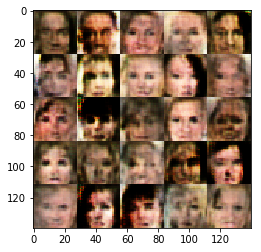

Epoch 2/3... Discriminator Loss: 1.2418... Generator Loss: 0.9158


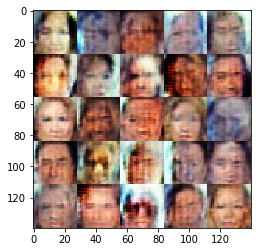

Epoch 2/3... Discriminator Loss: 1.3225... Generator Loss: 0.7089


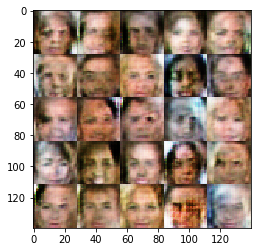

Epoch 2/3... Discriminator Loss: 1.2751... Generator Loss: 0.6843


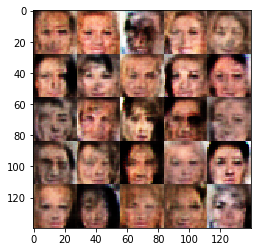

Epoch 2/3... Discriminator Loss: 1.3227... Generator Loss: 0.7700


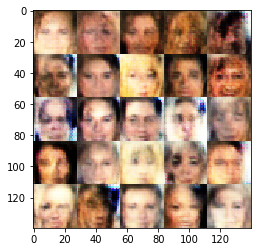

Epoch 2/3... Discriminator Loss: 1.2345... Generator Loss: 0.6798


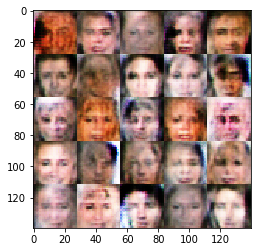

Epoch 2/3... Discriminator Loss: 1.4375... Generator Loss: 0.5575


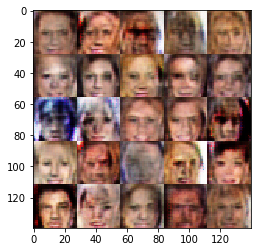

Epoch 2/3... Discriminator Loss: 1.4073... Generator Loss: 0.6607


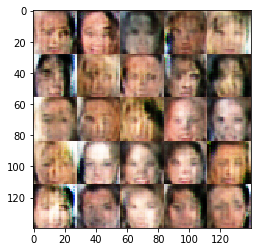

Epoch 2/3... Discriminator Loss: 1.3619... Generator Loss: 0.6365


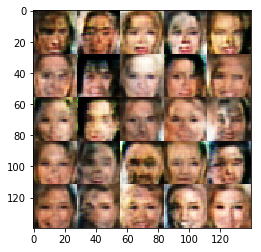

Epoch 2/3... Discriminator Loss: 1.4839... Generator Loss: 0.5911


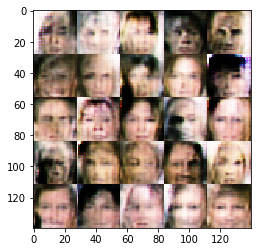

Epoch 2/3... Discriminator Loss: 1.5158... Generator Loss: 1.2631


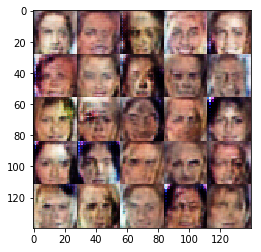

Epoch 2/3... Discriminator Loss: 1.7373... Generator Loss: 1.0768


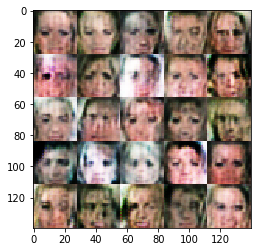

Epoch 2/3... Discriminator Loss: 1.2639... Generator Loss: 0.7997


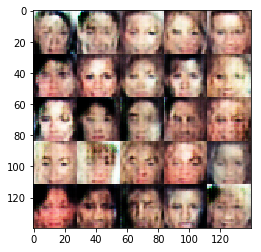

Epoch 2/3... Discriminator Loss: 1.4003... Generator Loss: 0.7485


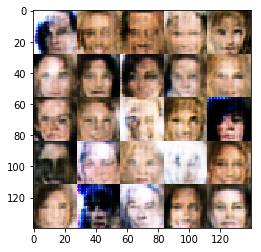

Epoch 2/3... Discriminator Loss: 1.3741... Generator Loss: 0.6218


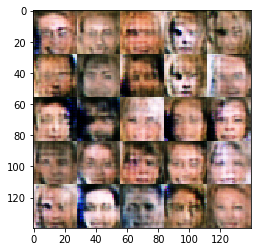

Epoch 2/3... Discriminator Loss: 1.2506... Generator Loss: 0.7448


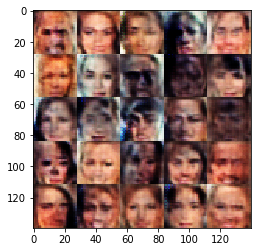

Epoch 2/3... Discriminator Loss: 1.3199... Generator Loss: 0.6894


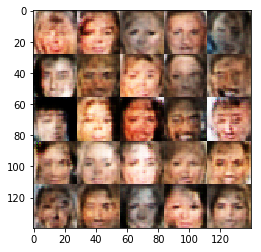

Epoch 3/3... Discriminator Loss: 1.3756... Generator Loss: 0.6986


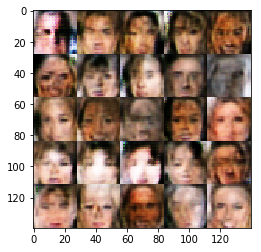

Epoch 3/3... Discriminator Loss: 1.3598... Generator Loss: 0.7229


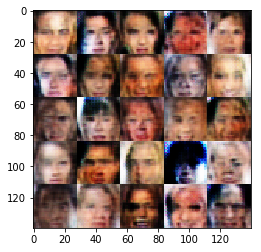

Epoch 3/3... Discriminator Loss: 1.2891... Generator Loss: 0.7868


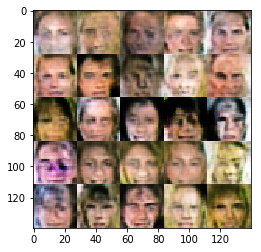

Epoch 3/3... Discriminator Loss: 1.3878... Generator Loss: 0.9482


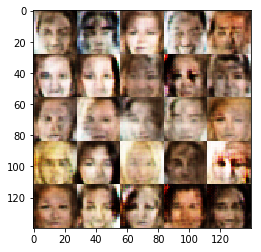

Epoch 3/3... Discriminator Loss: 1.4186... Generator Loss: 0.6540


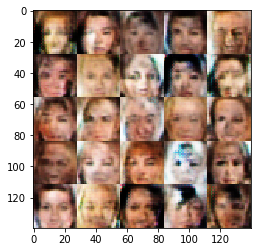

Epoch 3/3... Discriminator Loss: 1.3720... Generator Loss: 0.9644


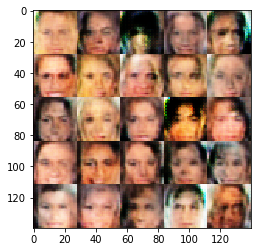

Epoch 3/3... Discriminator Loss: 1.2582... Generator Loss: 0.7192


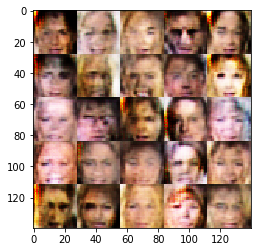

Epoch 3/3... Discriminator Loss: 1.4492... Generator Loss: 0.6335


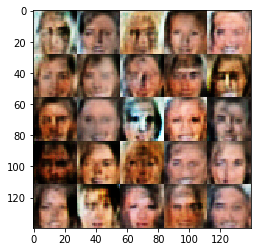

Epoch 3/3... Discriminator Loss: 1.4488... Generator Loss: 0.4857


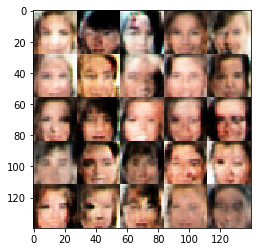

Epoch 3/3... Discriminator Loss: 1.4717... Generator Loss: 0.8309


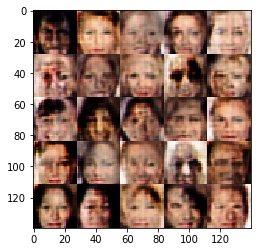

Epoch 3/3... Discriminator Loss: 1.4011... Generator Loss: 0.8401


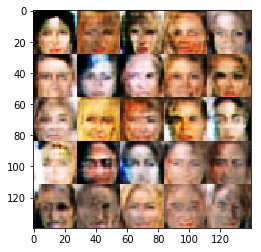

Epoch 3/3... Discriminator Loss: 1.4986... Generator Loss: 0.7290


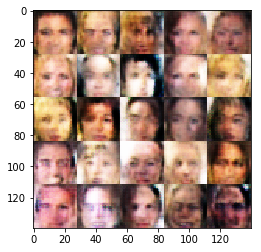

Epoch 3/3... Discriminator Loss: 1.2367... Generator Loss: 0.7637


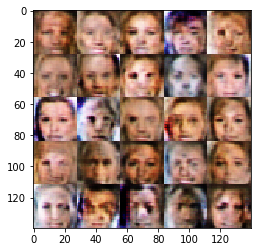

Epoch 3/3... Discriminator Loss: 1.6293... Generator Loss: 0.3907


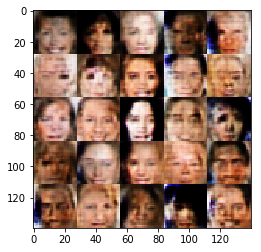

Epoch 3/3... Discriminator Loss: 1.2793... Generator Loss: 0.7803


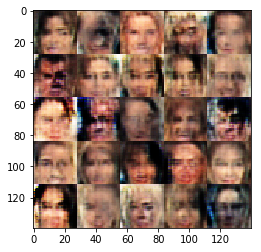

Epoch 3/3... Discriminator Loss: 1.3641... Generator Loss: 0.6843


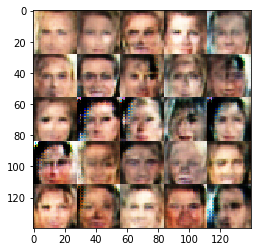

Epoch 3/3... Discriminator Loss: 1.3794... Generator Loss: 0.8431


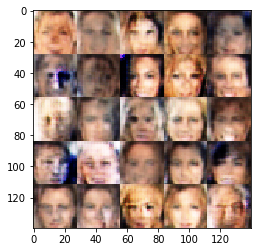

Epoch 3/3... Discriminator Loss: 1.3599... Generator Loss: 0.7654


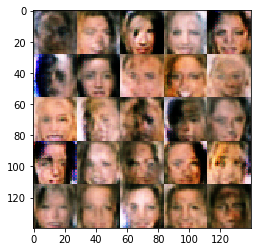

Epoch 3/3... Discriminator Loss: 1.3530... Generator Loss: 0.8914


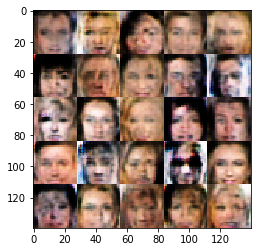

Epoch 3/3... Discriminator Loss: 1.3188... Generator Loss: 0.8429


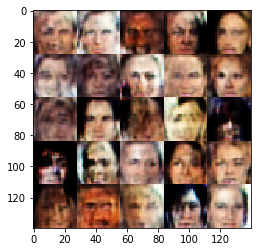

Epoch 3/3... Discriminator Loss: 1.3766... Generator Loss: 0.7965


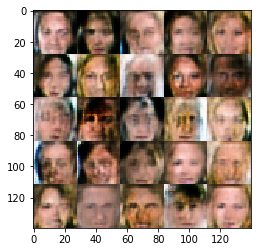

Epoch 3/3... Discriminator Loss: 1.3177... Generator Loss: 0.7602


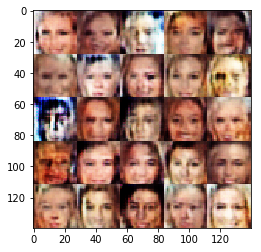

Epoch 3/3... Discriminator Loss: 1.3537... Generator Loss: 0.7318


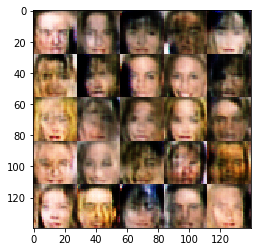

Epoch 3/3... Discriminator Loss: 1.1845... Generator Loss: 0.7857


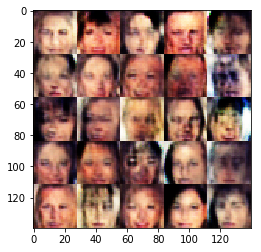

Epoch 3/3... Discriminator Loss: 1.3982... Generator Loss: 0.8607


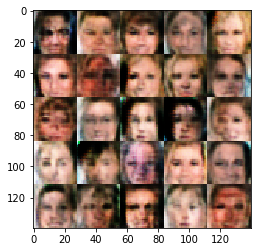

Epoch 3/3... Discriminator Loss: 1.4275... Generator Loss: 0.7434


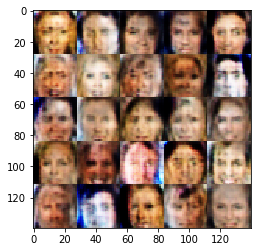

Epoch 3/3... Discriminator Loss: 1.3875... Generator Loss: 0.7348


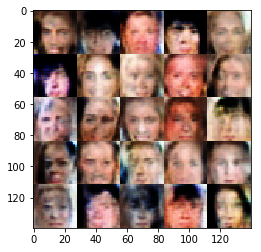

Epoch 3/3... Discriminator Loss: 1.3119... Generator Loss: 0.7023


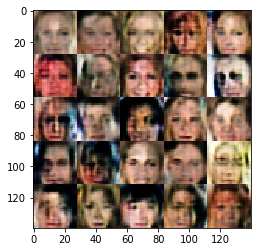

Epoch 3/3... Discriminator Loss: 1.4686... Generator Loss: 0.6979


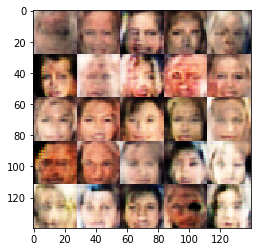

Epoch 3/3... Discriminator Loss: 1.4055... Generator Loss: 0.6214


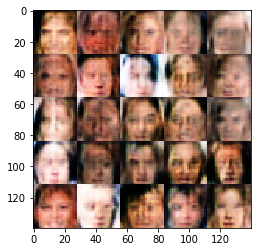

Epoch 3/3... Discriminator Loss: 1.3206... Generator Loss: 0.7526


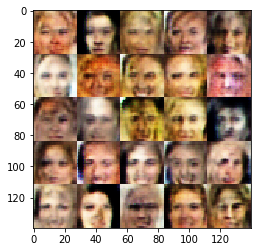

Epoch 3/3... Discriminator Loss: 1.3990... Generator Loss: 0.6141


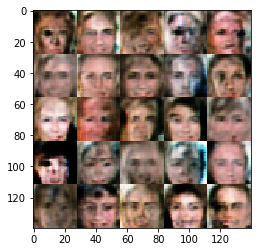

Epoch 3/3... Discriminator Loss: 1.3671... Generator Loss: 0.7190


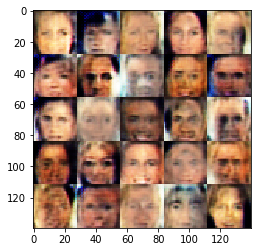

Epoch 3/3... Discriminator Loss: 1.3592... Generator Loss: 0.6949


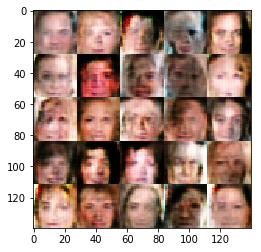

Epoch 3/3... Discriminator Loss: 1.3762... Generator Loss: 0.8325


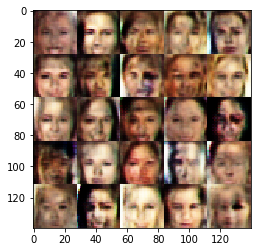

Epoch 3/3... Discriminator Loss: 1.4223... Generator Loss: 0.7169


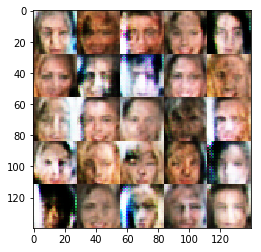

Epoch 3/3... Discriminator Loss: 1.4336... Generator Loss: 0.6444


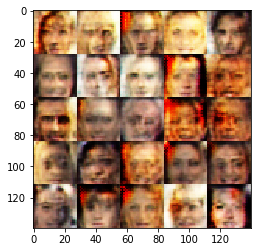

Epoch 3/3... Discriminator Loss: 1.3440... Generator Loss: 0.6185


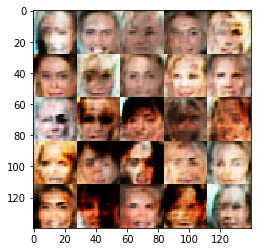

Epoch 3/3... Discriminator Loss: 1.3288... Generator Loss: 0.7077


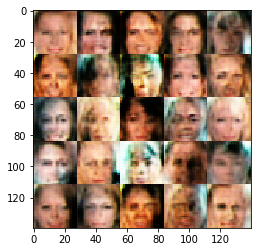

Epoch 3/3... Discriminator Loss: 1.3514... Generator Loss: 0.7352


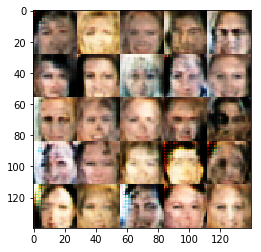

Epoch 3/3... Discriminator Loss: 1.2579... Generator Loss: 0.7911


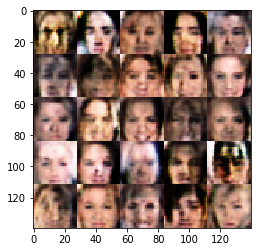

Epoch 3/3... Discriminator Loss: 1.3448... Generator Loss: 0.8007


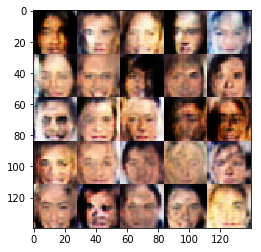

Epoch 3/3... Discriminator Loss: 1.3939... Generator Loss: 0.7354


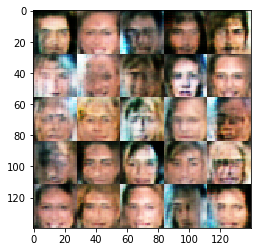

Epoch 3/3... Discriminator Loss: 1.2575... Generator Loss: 0.7385


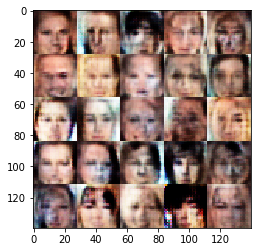

Epoch 3/3... Discriminator Loss: 1.4703... Generator Loss: 0.8088


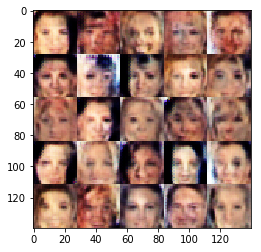

Epoch 3/3... Discriminator Loss: 1.3049... Generator Loss: 0.6949


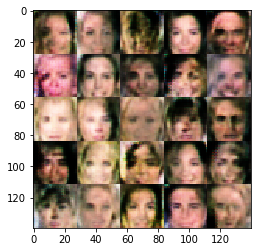

Epoch 3/3... Discriminator Loss: 1.3303... Generator Loss: 0.7187


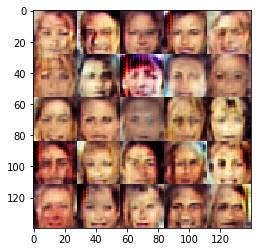

Epoch 3/3... Discriminator Loss: 1.2919... Generator Loss: 0.8594


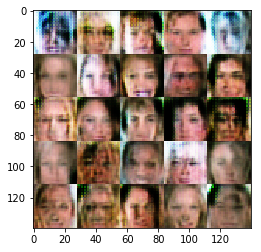

Epoch 3/3... Discriminator Loss: 1.4715... Generator Loss: 0.5403


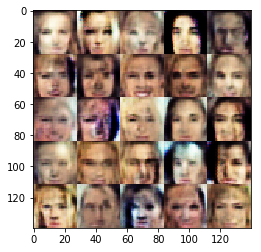

Epoch 3/3... Discriminator Loss: 1.4988... Generator Loss: 0.5888


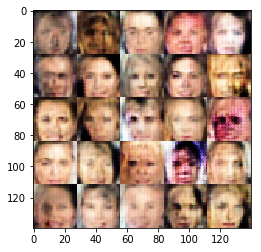

Epoch 3/3... Discriminator Loss: 1.2959... Generator Loss: 0.7355


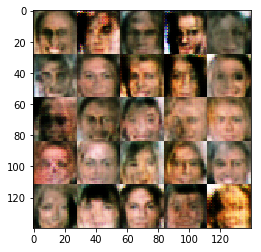

Epoch 3/3... Discriminator Loss: 1.3548... Generator Loss: 0.6921


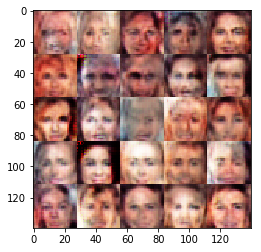

Epoch 3/3... Discriminator Loss: 1.4195... Generator Loss: 0.7004


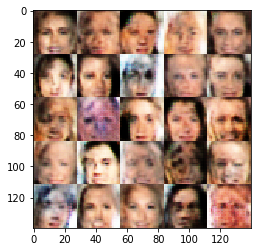

Epoch 3/3... Discriminator Loss: 1.4840... Generator Loss: 0.5644


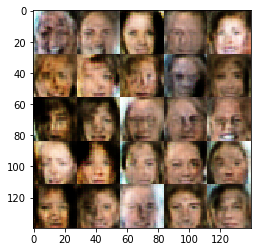

Epoch 3/3... Discriminator Loss: 1.2699... Generator Loss: 0.8870


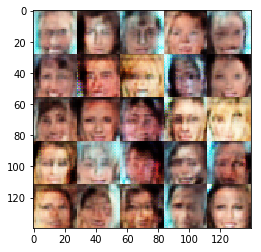

Epoch 3/3... Discriminator Loss: 1.3874... Generator Loss: 0.8788


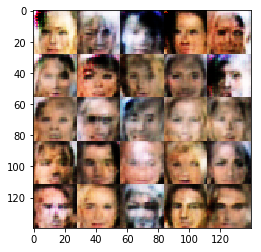

Epoch 3/3... Discriminator Loss: 1.4283... Generator Loss: 0.6770


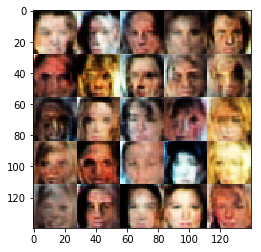

Epoch 3/3... Discriminator Loss: 1.4330... Generator Loss: 0.8416


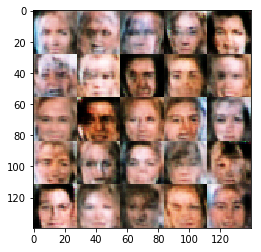

Epoch 3/3... Discriminator Loss: 1.5472... Generator Loss: 0.9173


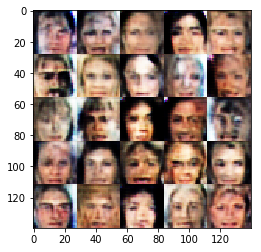

Epoch 3/3... Discriminator Loss: 1.3196... Generator Loss: 0.6657


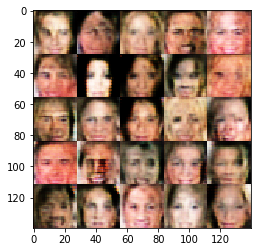

Epoch 3/3... Discriminator Loss: 1.2810... Generator Loss: 0.7977


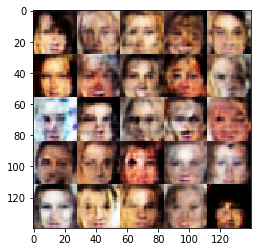

Epoch 3/3... Discriminator Loss: 1.3713... Generator Loss: 0.7127


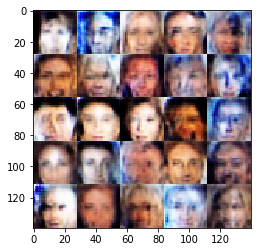

Epoch 3/3... Discriminator Loss: 1.2901... Generator Loss: 0.7002


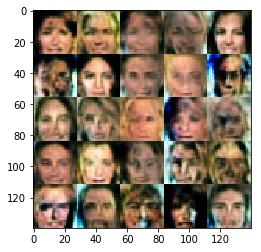

Epoch 3/3... Discriminator Loss: 1.3695... Generator Loss: 1.0695


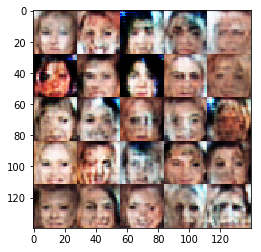

Epoch 3/3... Discriminator Loss: 1.3275... Generator Loss: 0.8397


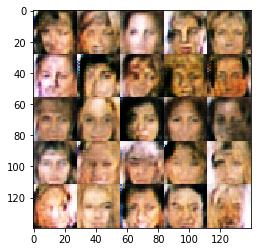

Epoch 3/3... Discriminator Loss: 1.5190... Generator Loss: 0.4319


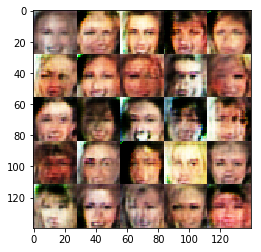

Epoch 3/3... Discriminator Loss: 1.3066... Generator Loss: 0.8693


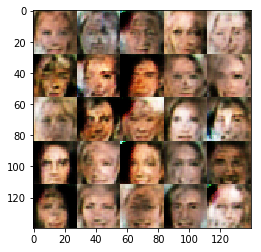

Epoch 3/3... Discriminator Loss: 1.3192... Generator Loss: 0.7544


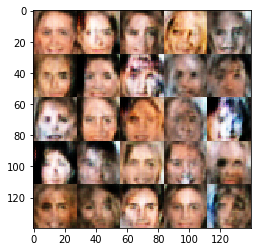

Epoch 3/3... Discriminator Loss: 1.3160... Generator Loss: 0.7917


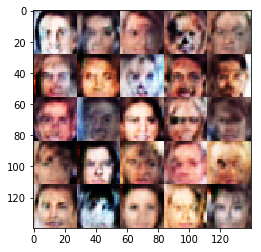

Epoch 3/3... Discriminator Loss: 1.4287... Generator Loss: 1.0775


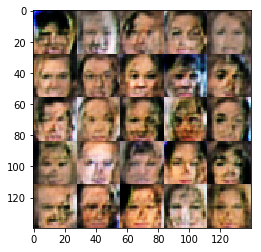

Epoch 3/3... Discriminator Loss: 1.3545... Generator Loss: 0.6653


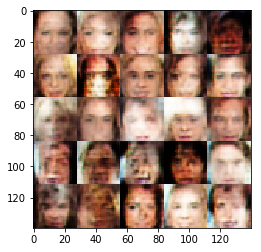

Epoch 3/3... Discriminator Loss: 1.1809... Generator Loss: 0.8055


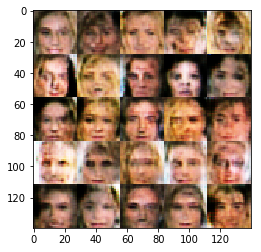

Epoch 3/3... Discriminator Loss: 1.3874... Generator Loss: 0.6397


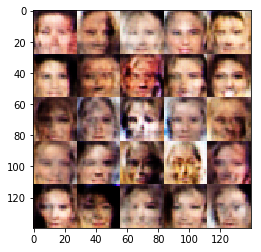

Epoch 3/3... Discriminator Loss: 1.2907... Generator Loss: 0.7410


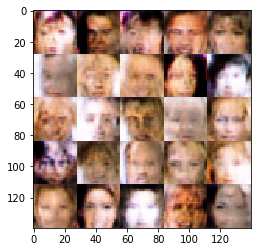

Epoch 3/3... Discriminator Loss: 1.2787... Generator Loss: 0.7513


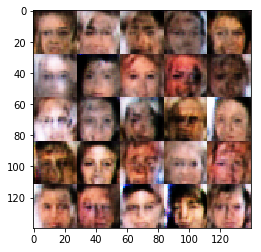

Epoch 3/3... Discriminator Loss: 1.2629... Generator Loss: 0.6961


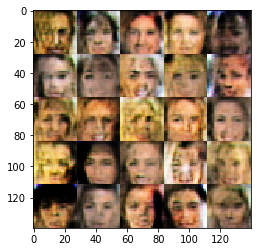

Epoch 3/3... Discriminator Loss: 1.3528... Generator Loss: 0.7495


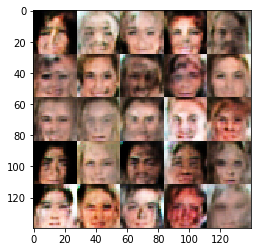

Epoch 3/3... Discriminator Loss: 1.3215... Generator Loss: 0.8436


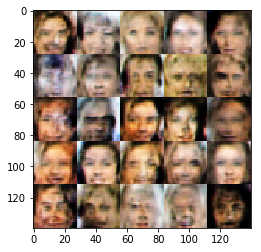

Epoch 3/3... Discriminator Loss: 1.3748... Generator Loss: 0.7202


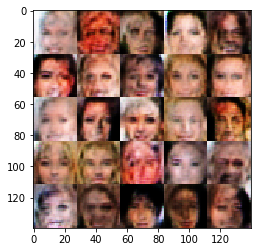

Epoch 3/3... Discriminator Loss: 1.3653... Generator Loss: 0.7532


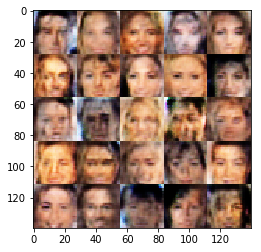

Epoch 3/3... Discriminator Loss: 1.2826... Generator Loss: 0.9081


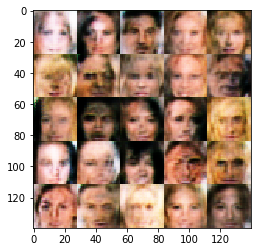

Epoch 3/3... Discriminator Loss: 1.3062... Generator Loss: 0.8411


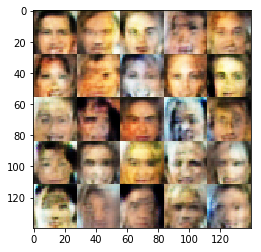

Epoch 3/3... Discriminator Loss: 1.2810... Generator Loss: 0.6345


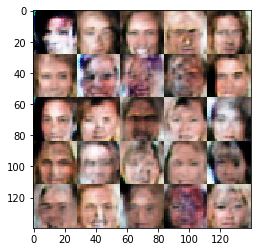

Epoch 3/3... Discriminator Loss: 1.3505... Generator Loss: 0.7103


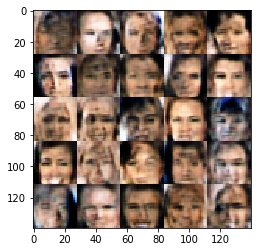

Epoch 3/3... Discriminator Loss: 1.4575... Generator Loss: 0.6800


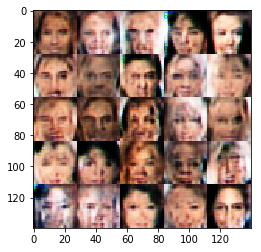

Epoch 3/3... Discriminator Loss: 1.4398... Generator Loss: 0.6233


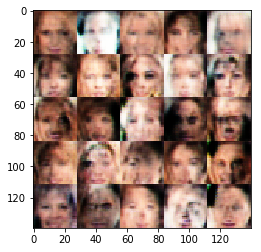

Epoch 3/3... Discriminator Loss: 1.2622... Generator Loss: 0.8265


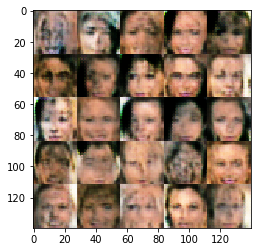

Epoch 3/3... Discriminator Loss: 1.3787... Generator Loss: 0.5945


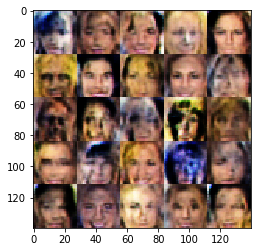

Epoch 3/3... Discriminator Loss: 1.2906... Generator Loss: 0.8528


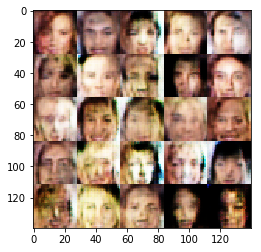

Epoch 3/3... Discriminator Loss: 1.2264... Generator Loss: 0.8989


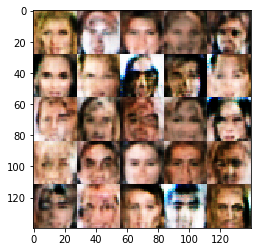

Epoch 3/3... Discriminator Loss: 1.3465... Generator Loss: 0.6957


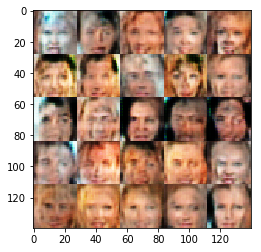

Epoch 3/3... Discriminator Loss: 1.2691... Generator Loss: 0.8324


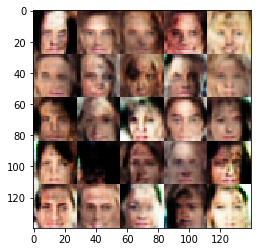

Epoch 3/3... Discriminator Loss: 1.3848... Generator Loss: 0.7586


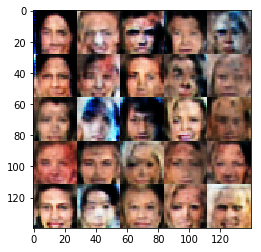

Epoch 3/3... Discriminator Loss: 1.4995... Generator Loss: 0.6407


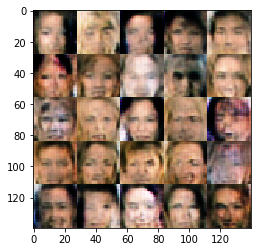

Epoch 3/3... Discriminator Loss: 1.3908... Generator Loss: 0.6384


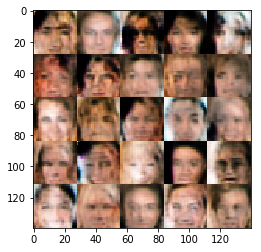

Epoch 3/3... Discriminator Loss: 1.2831... Generator Loss: 0.6426


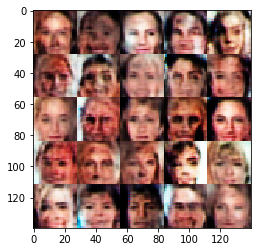

Epoch 3/3... Discriminator Loss: 1.3535... Generator Loss: 0.8021


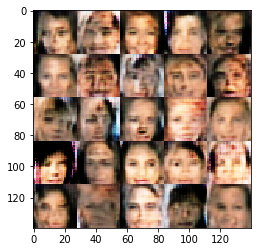

Epoch 3/3... Discriminator Loss: 1.3697... Generator Loss: 0.6816


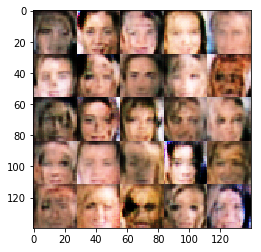

Epoch 3/3... Discriminator Loss: 1.3958... Generator Loss: 0.7595


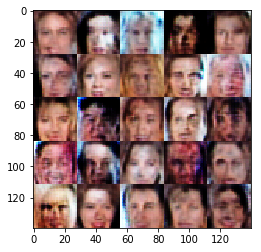

Epoch 3/3... Discriminator Loss: 1.3364... Generator Loss: 0.7296


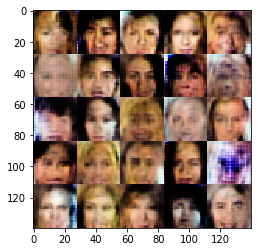

Epoch 3/3... Discriminator Loss: 1.4275... Generator Loss: 0.7449


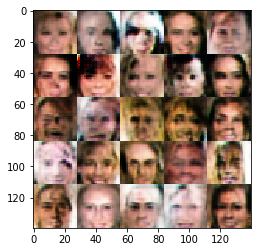

Epoch 3/3... Discriminator Loss: 1.3754... Generator Loss: 0.7698


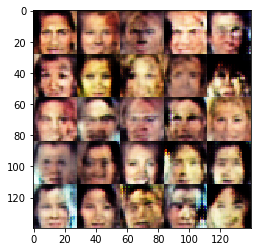

Epoch 3/3... Discriminator Loss: 1.3565... Generator Loss: 0.6630


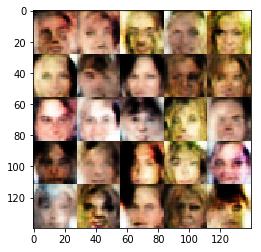

Epoch 3/3... Discriminator Loss: 1.3693... Generator Loss: 0.6342


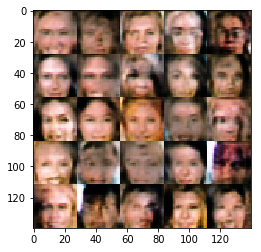

Epoch 3/3... Discriminator Loss: 1.3311... Generator Loss: 0.8530


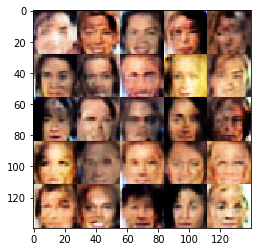

Epoch 3/3... Discriminator Loss: 1.3962... Generator Loss: 0.7985


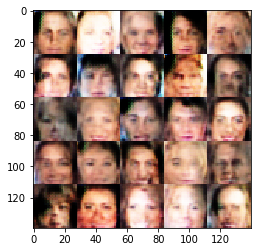

Epoch 3/3... Discriminator Loss: 1.3418... Generator Loss: 0.6932


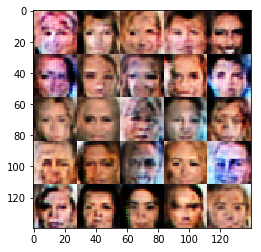

Epoch 3/3... Discriminator Loss: 1.4470... Generator Loss: 0.8408


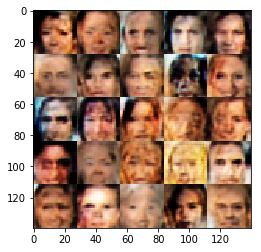

Epoch 3/3... Discriminator Loss: 1.3617... Generator Loss: 0.7223


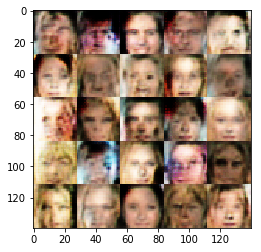

Epoch 3/3... Discriminator Loss: 1.4068... Generator Loss: 0.6586


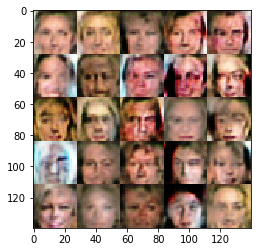

Epoch 3/3... Discriminator Loss: 1.3733... Generator Loss: 0.7612


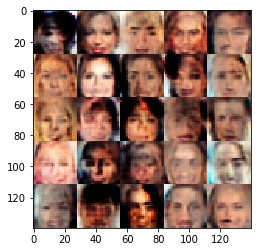

Epoch 3/3... Discriminator Loss: 1.3282... Generator Loss: 0.7282


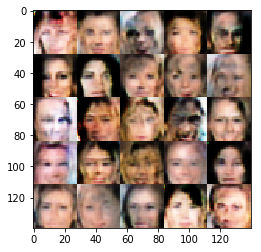

Epoch 3/3... Discriminator Loss: 1.4972... Generator Loss: 0.5608


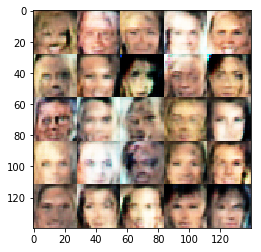

Epoch 3/3... Discriminator Loss: 1.3610... Generator Loss: 0.6343


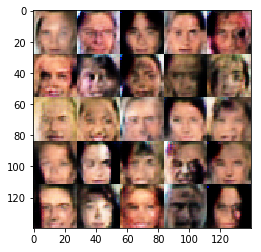

Epoch 3/3... Discriminator Loss: 1.4148... Generator Loss: 0.7553


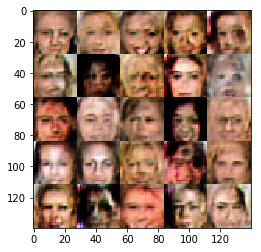

Epoch 3/3... Discriminator Loss: 1.3037... Generator Loss: 0.7465


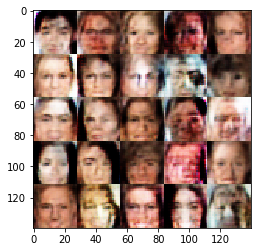

Epoch 3/3... Discriminator Loss: 1.2207... Generator Loss: 0.7411


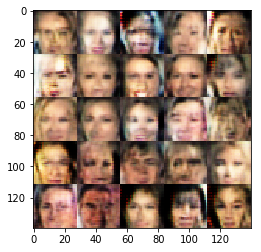

Epoch 3/3... Discriminator Loss: 1.3599... Generator Loss: 0.6405


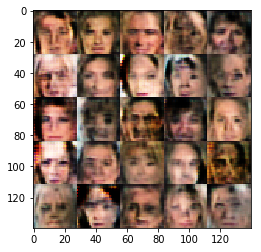

Epoch 3/3... Discriminator Loss: 1.3769... Generator Loss: 0.8881


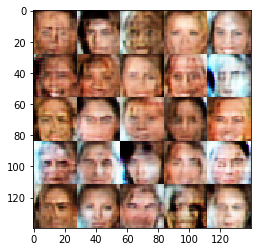

Epoch 3/3... Discriminator Loss: 1.3884... Generator Loss: 0.7807


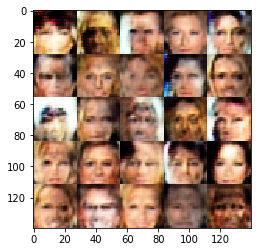

Epoch 3/3... Discriminator Loss: 1.3501... Generator Loss: 0.7568


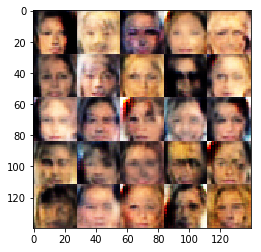

Epoch 3/3... Discriminator Loss: 1.4604... Generator Loss: 0.4701


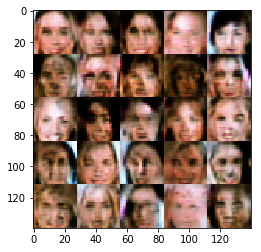

Epoch 3/3... Discriminator Loss: 1.4018... Generator Loss: 0.8183


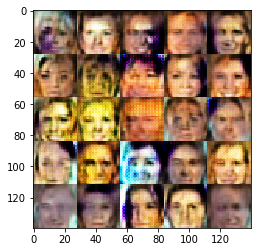

Epoch 3/3... Discriminator Loss: 1.3445... Generator Loss: 0.6254


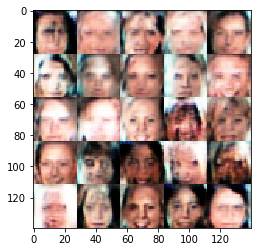

Epoch 3/3... Discriminator Loss: 1.3325... Generator Loss: 0.5838


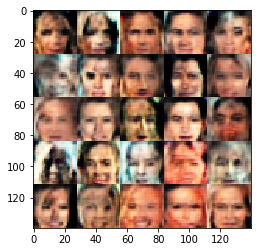

Epoch 3/3... Discriminator Loss: 1.3756... Generator Loss: 0.7770


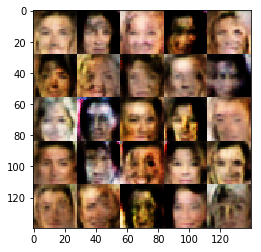

Epoch 3/3... Discriminator Loss: 1.2311... Generator Loss: 0.7880


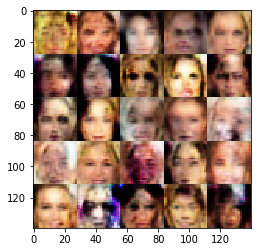

Epoch 3/3... Discriminator Loss: 1.3339... Generator Loss: 0.5900


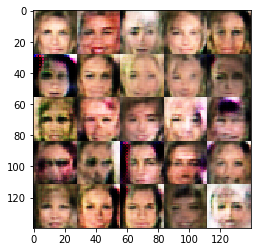

Epoch 3/3... Discriminator Loss: 1.3571... Generator Loss: 0.7913


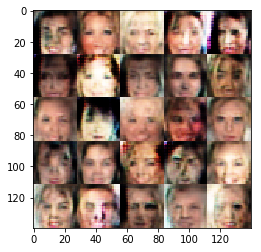

Epoch 3/3... Discriminator Loss: 1.3980... Generator Loss: 0.8329


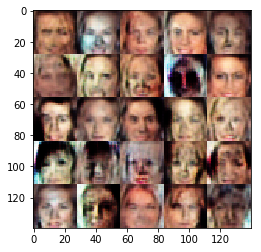

Epoch 3/3... Discriminator Loss: 1.3065... Generator Loss: 0.7089


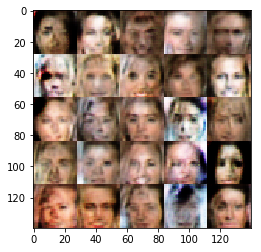

Epoch 3/3... Discriminator Loss: 1.3877... Generator Loss: 0.7068


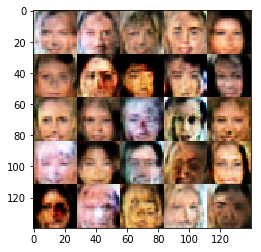

Epoch 3/3... Discriminator Loss: 1.3780... Generator Loss: 0.6917


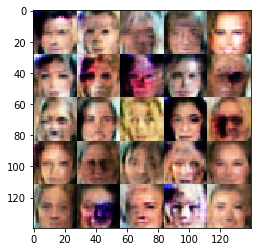

Epoch 3/3... Discriminator Loss: 1.3254... Generator Loss: 0.7959


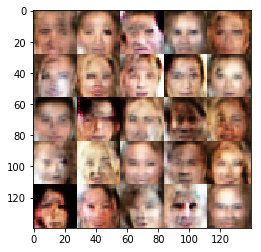

Epoch 3/3... Discriminator Loss: 1.3737... Generator Loss: 0.6452


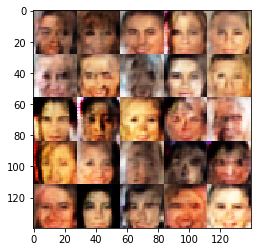

Epoch 3/3... Discriminator Loss: 1.4211... Generator Loss: 0.7072


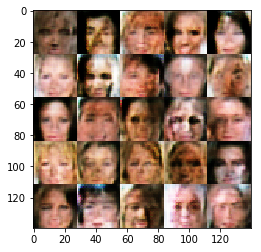

Epoch 3/3... Discriminator Loss: 1.2687... Generator Loss: 0.7917


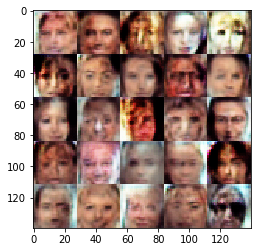

Epoch 3/3... Discriminator Loss: 1.3560... Generator Loss: 0.6945


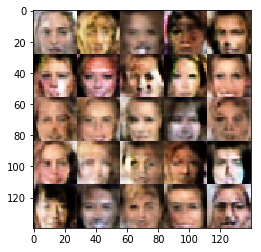

Epoch 3/3... Discriminator Loss: 1.3118... Generator Loss: 0.7251


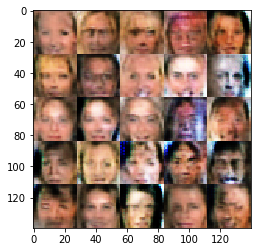

Epoch 3/3... Discriminator Loss: 1.3331... Generator Loss: 0.6162


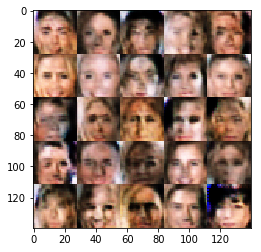

Epoch 3/3... Discriminator Loss: 1.4613... Generator Loss: 0.7221


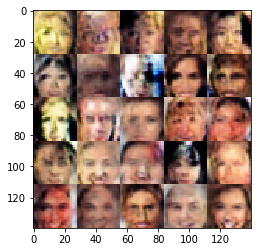

Epoch 3/3... Discriminator Loss: 1.5152... Generator Loss: 0.9274


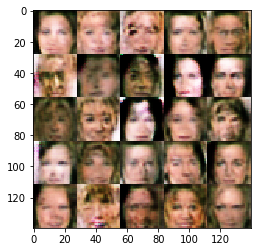

Epoch 3/3... Discriminator Loss: 1.4096... Generator Loss: 1.1060


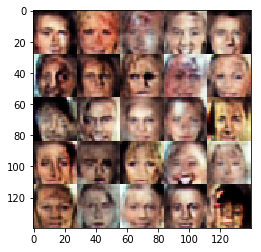

Epoch 3/3... Discriminator Loss: 1.4458... Generator Loss: 0.7454


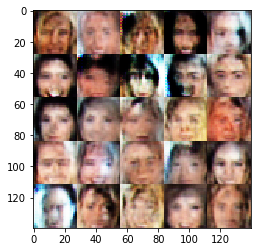

Epoch 3/3... Discriminator Loss: 1.3415... Generator Loss: 0.7647


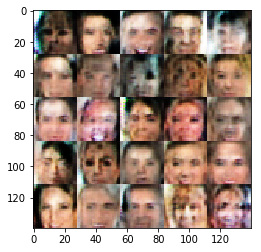

Epoch 3/3... Discriminator Loss: 1.3640... Generator Loss: 0.6713


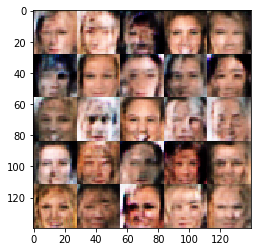

Epoch 3/3... Discriminator Loss: 1.3819... Generator Loss: 0.8421


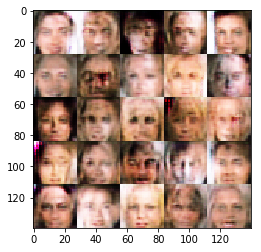

Epoch 3/3... Discriminator Loss: 1.2594... Generator Loss: 0.6585


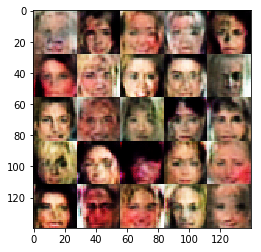

Epoch 3/3... Discriminator Loss: 1.2204... Generator Loss: 0.7745


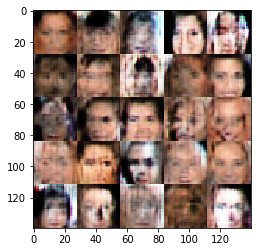

Epoch 3/3... Discriminator Loss: 1.3293... Generator Loss: 0.7662


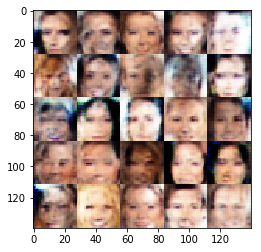

Epoch 3/3... Discriminator Loss: 1.3317... Generator Loss: 0.7341


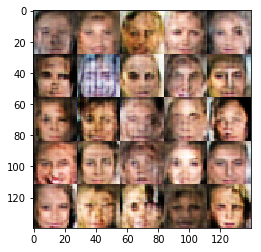

Epoch 3/3... Discriminator Loss: 1.3193... Generator Loss: 0.9070


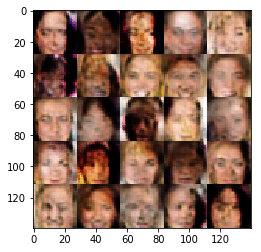

Epoch 3/3... Discriminator Loss: 1.3646... Generator Loss: 0.7366


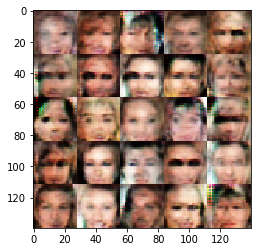

Epoch 3/3... Discriminator Loss: 1.4103... Generator Loss: 0.6872


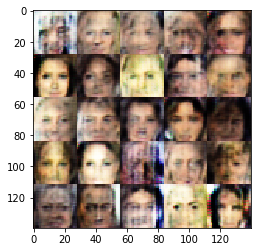

Epoch 3/3... Discriminator Loss: 1.3391... Generator Loss: 0.7464


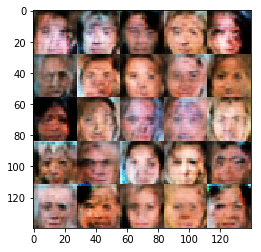

Epoch 3/3... Discriminator Loss: 1.3705... Generator Loss: 0.8660


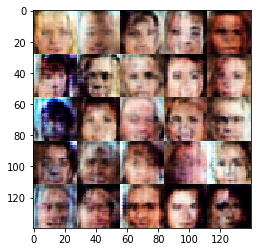

Epoch 3/3... Discriminator Loss: 1.3638... Generator Loss: 0.8741


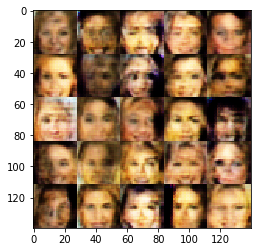

Epoch 3/3... Discriminator Loss: 1.3756... Generator Loss: 1.0081


In [413]:
batch_size = 128
z_dim = 128
learning_rate = 0.001
beta1 = 0.5

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 3

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.